### Set up tensorflow as backend

In [1]:
import tensorflow as tf
from keras import backend as K

num_cores = 4
num_GPU = 1
num_CPU = 1
gpu_mem_fraction = 0.8


config = tf.ConfigProto(intra_op_parallelism_threads=num_cores,
                        inter_op_parallelism_threads=num_cores, allow_soft_placement=True,
                        device_count = {'CPU' : num_CPU, 'GPU' : num_GPU}, log_device_placement=True)
config.gpu_options.per_process_gpu_memory_fraction = gpu_mem_fraction
# alternatively
# config.gpu_options.allow_growth = True

session = tf.Session(config=config)
K.set_session(session)

/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/importlib/_bootstrap.py:321: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  return f(*args, **kwds)
Using TensorFlow backend.


### Imports section

In [2]:
import os
from tqdm import tqdm
from keras.preprocessing import image
import numpy as np
from PIL import Image
from IPython.core.display import display

from scipy import ndimage
import matplotlib.pyplot as plt 
%matplotlib inline
from skimage.measure import block_reduce

from quiver_engine import server

from keras.applications.imagenet_utils import decode_predictions
from keras.applications.imagenet_utils import preprocess_input



from keras.preprocessing.image import ImageDataGenerator
from keras.optimizers import SGD

import gc

from keras.applications.imagenet_utils import preprocess_input

from keras.layers import Dropout

from keras.optimizers import Adam
from keras.callbacks import TensorBoard,ModelCheckpoint,EarlyStopping
import pickle

import random
from shutil import copyfile, copytree

### Utils section

In [4]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

In [15]:
DEMO=True

In [16]:
def read_images_in_folder(folder, target_size = (224, 224), preprocess = None):
    """ Reads all the images in a given folder and returns them as a list
    """
    list_original = []
    list_processed = []
    for img_path in tqdm(os.listdir(folder)):
        full_path = os.path.join(folder,img_path)
        img = image.load_img(full_path, target_size=target_size)
        img_data = image.img_to_array(img)
        img_data = np.expand_dims(img_data, axis=0)
        if preprocess:
            img_data = preprocess_input(img_data)

        list_processed.append(img_data)
        list_original.append(full_path)
    
    return (list_processed, list_original)

def display_image_and_caption(images,captions = None):
    """display the image  and the caption if present
    """
    if not captions:
        captions = ""
    
    display(Image.open(images))
    print(captions)
        

def display_images_and_captions(images,captions = None):
    """display each of the image in images and the caption if present
    """
    if not captions:
        captions = [""] * len(images)
    
    for item in zip(images,captions):
        display_image_and_caption(item[0],item[1])
        print(" ")
        

# Image classification the lazy way

Our news feed is filled with cats pictures and people posting selfies from holiday. We want to automatically tell what a picture will contain. For this we are going to train our own deep learning  image classifier.

For now we want to tell if an image contains a cat or a dog. 

<img src="Presentation/Graphics/cat.12352.jpg" />
    
<p><center>cat</center></p>

<img src="Presentation/Graphics/dog.12108.jpg" />
    
<p><center>dog</center></p>


Sometimes a cat may try to disguise as a dog or a dog as a cat, but we will try to not get fooled.
### image of cat as dog

## ImageNet 

[ImageNet](http://image-net.org/) is an human-annotated image dataset.There are a total number of 14,197,122 images and 21841 synsets (i.e labels, categories). We can [explore](http://image-net.org/explore) the dataset to understand the effort that takes building it.

It is famously known because of the [Large Scale Visual Recognition Challenge](http://www.image-net.org/challenges/LSVRC/) where the goal is to produce the topt 5 most probable object categories out of the [1000 categories](http://www.image-net.org/challenges/LSVRC/2010/browse-synsets) cotained in the test image. The training set contains 1.2 million images algorithms.

This challenge has pushed the boundaries of deep learning for image classification and top ranking solutions (lately all submitted solutions) are based on a deep learning architecture.



# Convolutional Neural Networks 
## VGG16

VGG is a convolutional neural network model proposed by K. Simonyan and A. Zisserman from the University of Oxford in the paper “Very Deep Convolutional Networks for Large-Scale Image Recognition” . The model achieves 92.7% top-5 test accuracy in ImageNet , which is a dataset of over 14 million images belonging to 1000 classes.

<img src="Presentation/Graphics/vgg16.png" />
[https://www.cs.toronto.edu/~frossard/post/vgg16/]


### Convolution and pooling

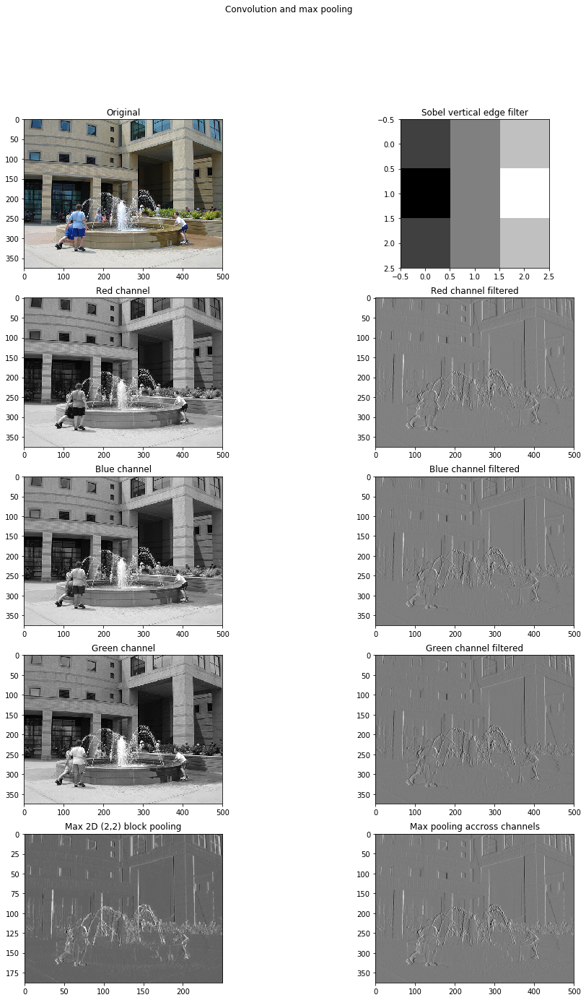

<Figure size 432x288 with 0 Axes>

In [17]:
img_for_conv_path = 'Presentation/misc/180094434_b0f244832d.jpg'
img_orig = image.load_img(img_for_conv_path)
img_data = image.img_to_array(img_orig)

img_conv = np.zeros(img_data.shape)

h_filter = np.array([[-1,0,1],[-2,0,2],[-1,0,1]])
for i in range(3):
    img_conv[:,:,i] = ndimage.convolve(img_data[:,:,i], h_filter, mode='reflect')
    
img_pooled_channels = np.amax(img_conv, axis=2)    
img_pooled_2d = block_reduce(img_pooled_channels, (2,2), np.max)


gray_colormap = plt.get_cmap('gray')

f, ((ax1, ax2), (ax3, ax4), (ax5, ax6), (ax7, ax8), (ax9, ax10)) = plt.subplots(5, 2,figsize=(16, 22))
plt.figure() 
f.suptitle("Convolution and max pooling", fontsize=12)
ax1.imshow(img_orig)
ax1.set_title("Original")
ax2.imshow(h_filter,cmap=gray_colormap)
ax2.set_title("Sobel vertical edge filter")
ax3.imshow(img_data[:,:,0],cmap=gray_colormap)
ax3.set_title("Red channel")
ax4.imshow(img_conv[:,:,0],cmap=gray_colormap)
ax4.set_title("Red channel filtered")
ax5.imshow(img_data[:,:,1],cmap=gray_colormap)
ax5.set_title("Blue channel")
ax6.imshow(img_conv[:,:,1],cmap=gray_colormap)
ax6.set_title("Blue channel filtered")
ax7.imshow(img_data[:,:,2],cmap=gray_colormap)
ax7.set_title("Green channel")
ax8.imshow(img_conv[:,:,2],cmap=gray_colormap)
ax8.set_title("Green channel filtered")
ax9.imshow(img_pooled_2d,cmap=gray_colormap)
ax9.set_title("Max 2D (2,2) block pooling")
ax10.imshow(img_pooled_channels,cmap=gray_colormap)
ax10.set_title("Max pooling accross channels")

plt.show()    

## VGG16 architecture

An architecture with very small (3x3) convolution filters and only 16 weight layers.

<img src="Presentation/Graphics/vgg16_detailed.png" />
[https://www.quora.com/What-is-the-VGG-neural-network]

## Keras

[Keras] is a high-level deep learning framework abstracting the use of the libraries [TensorFlow](https://www.tensorflow.org/) or [Theano](http://deeplearning.net/software/theano/). It is developed with a focus on enabling fast experimentation.

For TensorFlow there is also the choice of [TFLearn](http://tflearn.org/)

In [18]:
# code taken from https://github.com/keras-team/keras/blob/master/keras/applications/vgg16.py

"""VGG16 model for Keras.
# Reference
- [Very Deep Convolutional Networks for Large-Scale Image Recognition](https://arxiv.org/abs/1409.1556)
"""
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

import os
import warnings

from keras.models import Model
from keras.layers import Flatten
from keras.layers import Dense
from keras.layers import Input
from keras.layers import Conv2D
from keras.layers import MaxPooling2D
from keras.layers import GlobalAveragePooling2D
from keras.layers import GlobalMaxPooling2D
from keras.engine import get_source_inputs
from keras.utils import layer_utils
from keras.utils.data_utils import get_file
from keras import backend as K
from keras.applications.imagenet_utils import decode_predictions
from keras.applications.imagenet_utils import preprocess_input
from keras.applications.imagenet_utils import _obtain_input_shape


WEIGHTS_PATH = 'https://github.com/fchollet/deep-learning-models/releases/download/v0.1/vgg16_weights_tf_dim_ordering_tf_kernels.h5'
WEIGHTS_PATH_NO_TOP = 'https://github.com/fchollet/deep-learning-models/releases/download/v0.1/vgg16_weights_tf_dim_ordering_tf_kernels_notop.h5'


def KerasVGG16(include_top=True, weights='imagenet',
          input_tensor=None, input_shape=None,
          pooling=None,
          classes=1000):
    """Instantiates the VGG16 architecture.
    Optionally loads weights pre-trained
    on ImageNet. Note that when using TensorFlow,
    for best performance you should set
    `image_data_format='channels_last'` in your Keras config
    at ~/.keras/keras.json.
    The model and the weights are compatible with both
    TensorFlow and Theano. The data format
    convention used by the model is the one
    specified in your Keras config file.
    # Arguments
        include_top: whether to include the 3 fully-connected
            layers at the top of the network.
        weights: one of `None` (random initialization),
              'imagenet' (pre-training on ImageNet),
              or the path to the weights file to be loaded.
        input_tensor: optional Keras tensor (i.e. output of `layers.Input()`)
            to use as image input for the model.
        input_shape: optional shape tuple, only to be specified
            if `include_top` is False (otherwise the input shape
            has to be `(224, 224, 3)` (with `channels_last` data format)
            or `(3, 224, 224)` (with `channels_first` data format).
            It should have exactly 3 input channels,
            and width and height should be no smaller than 48.
            E.g. `(200, 200, 3)` would be one valid value.
        pooling: Optional pooling mode for feature extraction
            when `include_top` is `False`.
            - `None` means that the output of the model will be
                the 4D tensor output of the
                last convolutional layer.
            - `avg` means that global average pooling
                will be applied to the output of the
                last convolutional layer, and thus
                the output of the model will be a 2D tensor.
            - `max` means that global max pooling will
                be applied.
        classes: optional number of classes to classify images
            into, only to be specified if `include_top` is True, and
            if no `weights` argument is specified.
    # Returns
        A Keras model instance.
    # Raises
        ValueError: in case of invalid argument for `weights`,
            or invalid input shape.
    """
    if not (weights in {'imagenet', None} or os.path.exists(weights)):
        raise ValueError('The `weights` argument should be either '
                         '`None` (random initialization), `imagenet` '
                         '(pre-training on ImageNet), '
                         'or the path to the weights file to be loaded.')

    if weights == 'imagenet' and include_top and classes != 1000:
        raise ValueError('If using `weights` as imagenet with `include_top`'
                         ' as true, `classes` should be 1000')
    # Determine proper input shape
    input_shape = _obtain_input_shape(input_shape,
                                      default_size=224,
                                      min_size=48,
                                      data_format=K.image_data_format(),
                                      require_flatten=include_top,
                                      weights=weights)

    if input_tensor is None:
        img_input = Input(shape=input_shape)
    else:
        if not K.is_keras_tensor(input_tensor):
            img_input = Input(tensor=input_tensor, shape=input_shape)
        else:
            img_input = input_tensor
    # Block 1
    x = Conv2D(64, (3, 3), activation='relu', padding='same', name='block1_conv1')(img_input)
    x = Conv2D(64, (3, 3), activation='relu', padding='same', name='block1_conv2')(x)
    x = MaxPooling2D((2, 2), strides=(2, 2), name='block1_pool')(x)

    # Block 2
    x = Conv2D(128, (3, 3), activation='relu', padding='same', name='block2_conv1')(x)
    x = Conv2D(128, (3, 3), activation='relu', padding='same', name='block2_conv2')(x)
    x = MaxPooling2D((2, 2), strides=(2, 2), name='block2_pool')(x)

    # Block 3
    x = Conv2D(256, (3, 3), activation='relu', padding='same', name='block3_conv1')(x)
    x = Conv2D(256, (3, 3), activation='relu', padding='same', name='block3_conv2')(x)
    x = Conv2D(256, (3, 3), activation='relu', padding='same', name='block3_conv3')(x)
    x = MaxPooling2D((2, 2), strides=(2, 2), name='block3_pool')(x)

    # Block 4
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block4_conv1')(x)
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block4_conv2')(x)
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block4_conv3')(x)
    x = MaxPooling2D((2, 2), strides=(2, 2), name='block4_pool')(x)

    # Block 5
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block5_conv1')(x)
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block5_conv2')(x)
    x = Conv2D(512, (3, 3), activation='relu', padding='same', name='block5_conv3')(x)
    x = MaxPooling2D((2, 2), strides=(2, 2), name='block5_pool')(x)

    if include_top:
        # Classification block
        x = Flatten(name='flatten')(x)
        x = Dense(4096, activation='relu', name='fc1')(x)
        x = Dense(4096, activation='relu', name='fc2')(x)
        x = Dense(classes, activation='softmax', name='predictions')(x)
    else:
        if pooling == 'avg':
            x = GlobalAveragePooling2D()(x)
        elif pooling == 'max':
            x = GlobalMaxPooling2D()(x)

    # Ensure that the model takes into account
    # any potential predecessors of `input_tensor`.
    if input_tensor is not None:
        inputs = get_source_inputs(input_tensor)
    else:
        inputs = img_input
    # Create model.
    model = Model(inputs, x, name='vgg16')

    # load weights
    if weights == 'imagenet':
        if include_top:
            weights_path = get_file('vgg16_weights_tf_dim_ordering_tf_kernels.h5',
                                    WEIGHTS_PATH,
                                    cache_subdir='models',
                                    file_hash='64373286793e3c8b2b4e3219cbf3544b')
        else:
            weights_path = get_file('vgg16_weights_tf_dim_ordering_tf_kernels_notop.h5',
                                    WEIGHTS_PATH_NO_TOP,
                                    cache_subdir='models',
                                    file_hash='6d6bbae143d832006294945121d1f1fc')
        model.load_weights(weights_path)
        if K.backend() == 'theano':
            layer_utils.convert_all_kernels_in_model(model)

        if K.image_data_format() == 'channels_first':
            if include_top:
                maxpool = model.get_layer(name='block5_pool')
                shape = maxpool.output_shape[1:]
                dense = model.get_layer(name='fc1')
                layer_utils.convert_dense_weights_data_format(dense, shape, 'channels_first')

            if K.backend() == 'tensorflow':
                warnings.warn('You are using the TensorFlow backend, yet you '
                              'are using the Theano '
                              'image data format convention '
                              '(`image_data_format="channels_first"`). '
                              'For best performance, set '
                              '`image_data_format="channels_last"` in '
                              'your Keras config '
                              'at ~/.keras/keras.json.')
    elif weights is not None:
        model.load_weights(weights)

    return model

### Explore the model

In [131]:
input_shape = (224,224,3)

vgg_full = KerasVGG16(weights='imagenet', include_top=True, input_shape=input_shape)
print(vgg_full.summary())

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_10 (InputLayer)        (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0         
__________

### Explore learned model

In [132]:
folder_in = "Test/imagenet"
list_img = read_images_in_folder(folder_in)

folder_out = "Test/imagenet_processed"
for img_idx in range(len(list_img[0])):
    data = np.squeeze(list_img[0][img_idx])
    im = Image.fromarray(data.astype('uint8'))
    im.save(os.path.join(folder_out,str(img_idx)+".png"))

100%|██████████| 7/7 [00:00<00:00, 109.17it/s]


In [18]:
from quiver_engine import server

folder = "Test/imagenet_processed"

server.launch(
        vgg_full, # a Keras Model     
        temp_folder='quiver_tmp', # where to store temporary files generatedby quiver (e.g. image files of layers)        
        input_folder=folder, # a folder where input images are stored        
        port=5001 # the localhost port the dashboard is to be served on
    )


Starting webserver from: /home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/quiver_engine


::ffff:127.0.0.1 - - [2018-05-06 19:01:24] "GET / HTTP/1.1" 200 824 0.014667
::ffff:127.0.0.1 - - [2018-05-06 19:01:24] "GET /app.c1d3d21cfba8c1aabed6806773c8f0ba.css HTTP/1.1" 200 5153 0.012095
::ffff:127.0.0.1 - - [2018-05-06 19:01:24] "GET /vendor.280c5ce1d78077ee8d66.js HTTP/1.1" 200 87579 0.001430
::ffff:127.0.0.1 - - [2018-05-06 19:01:24] "GET /app.14b8092d6ea379715007.js HTTP/1.1" 200 1179494 0.014042
::ffff:127.0.0.1 - - [2018-05-06 19:01:25] "GET /model HTTP/1.1" 200 11113 0.003902
::ffff:127.0.0.1 - - [2018-05-06 19:01:25] "GET /inputs HTTP/1.1" 200 232 0.001315
::ffff:127.0.0.1 - - [2018-05-06 19:01:25] "GET /input-file/2.png HTTP/1.1" 200 95777 0.001138
::ffff:127.0.0.1 - - [2018-05-06 19:01:25] "GET /input-file/0.png HTTP/1.1" 200 75521 0.001164
::ffff:127.0.0.1 - - [2018-05-06 19:01:25] "GET /input-file/4.png HTTP/1.1" 200 108759 0.001357
::ffff:127.0.0.1 - - [2018-05-06 19:01:25] "GET /input-file/1.png HTTP/1.1" 200 82543 0.001335
::ffff:127.0.0.1 - - [2018-05-06 19:01:2

Warning! you didn't pass your own set of classes for the model therefore imagenet classes are used


::ffff:127.0.0.1 - - [2018-05-06 19:01:31] "GET /predict/2.png HTTP/1.1" 200 403 0.976531
/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/quiver_engine/layer_result_generators.py:7: UserWarning: Update your `Model` call to the Keras 2 API: `Model(outputs=Tensor("in..., inputs=Tensor("in...)`
  output=model.get_layer(layer_name).output
::ffff:127.0.0.1 - - [2018-05-06 19:01:31] "GET /layer/input_1/2.png HTTP/1.1" 200 242 0.051572
::ffff:127.0.0.1 - - [2018-05-06 19:01:31] "GET /temp-file/input_1_0_2.png.png HTTP/1.1" 200 32613 0.001137
::ffff:127.0.0.1 - - [2018-05-06 19:01:31] "GET /temp-file/input_1_1_2.png.png HTTP/1.1" 200 32623 0.000840
::ffff:127.0.0.1 - - [2018-05-06 19:01:31] "GET /temp-file/input_1_2_2.png.png HTTP/1.1" 200 33869 0.001015
/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/quiver_engine/layer_result_generators.py:7: UserWarning: Update your `Model` call to the Keras 2 API: `Model(outputs=Tensor("bl..., inputs=Tensor("

::ffff:127.0.0.1 - - [2018-05-06 19:01:48] "GET /layer/block1_conv2/2.png HTTP/1.1" 200 1960 0.712598
::ffff:127.0.0.1 - - [2018-05-06 19:01:48] "GET /temp-file/block1_conv2_0_2.png.png HTTP/1.1" 200 33169 0.001187
::ffff:127.0.0.1 - - [2018-05-06 19:01:48] "GET /temp-file/block1_conv2_2_2.png.png HTTP/1.1" 200 8102 0.001142
::ffff:127.0.0.1 - - [2018-05-06 19:01:48] "GET /temp-file/block1_conv2_1_2.png.png HTTP/1.1" 200 32324 0.001147
::ffff:127.0.0.1 - - [2018-05-06 19:01:48] "GET /temp-file/block1_conv2_8_2.png.png HTTP/1.1" 200 14322 0.000991
::ffff:127.0.0.1 - - [2018-05-06 19:01:48] "GET /temp-file/block1_conv2_6_2.png.png HTTP/1.1" 200 31796 0.001138
::ffff:127.0.0.1 - - [2018-05-06 19:01:48] "GET /temp-file/block1_conv2_9_2.png.png HTTP/1.1" 200 26876 0.001004
::ffff:127.0.0.1 - - [2018-05-06 19:01:48] "GET /temp-file/block1_conv2_5_2.png.png HTTP/1.1" 200 33805 0.000994
::ffff:127.0.0.1 - - [2018-05-06 19:01:48] "GET /temp-file/block1_conv2_10_2.png.png HTTP/1.1" 200 32185 0.0

::ffff:127.0.0.1 - - [2018-05-06 19:01:57] "GET /temp-file/block1_pool_33_2.png.png HTTP/1.1" 200 9495 0.001104
::ffff:127.0.0.1 - - [2018-05-06 19:01:57] "GET /temp-file/block1_pool_34_2.png.png HTTP/1.1" 200 9058 0.000937
::ffff:127.0.0.1 - - [2018-05-06 19:01:57] "GET /temp-file/block1_pool_35_2.png.png HTTP/1.1" 200 9516 0.001189
::ffff:127.0.0.1 - - [2018-05-06 19:01:57] "GET /temp-file/block1_pool_36_2.png.png HTTP/1.1" 200 8568 0.000849
::ffff:127.0.0.1 - - [2018-05-06 19:01:57] "GET /temp-file/block1_pool_37_2.png.png HTTP/1.1" 200 8915 0.000702
::ffff:127.0.0.1 - - [2018-05-06 19:01:57] "GET /temp-file/block1_pool_38_2.png.png HTTP/1.1" 200 8386 0.000791
::ffff:127.0.0.1 - - [2018-05-06 19:01:57] "GET /temp-file/block1_pool_39_2.png.png HTTP/1.1" 200 8297 0.000941
::ffff:127.0.0.1 - - [2018-05-06 19:01:57] "GET /temp-file/block1_pool_40_2.png.png HTTP/1.1" 200 9393 0.000898
::ffff:127.0.0.1 - - [2018-05-06 19:01:57] "GET /temp-file/block1_pool_41_2.png.png HTTP/1.1" 200 9354 0

::ffff:127.0.0.1 - - [2018-05-06 19:02:00] "GET /temp-file/block2_conv1_60_2.png.png HTTP/1.1" 200 4357 0.001072
::ffff:127.0.0.1 - - [2018-05-06 19:02:00] "GET /temp-file/block2_conv1_61_2.png.png HTTP/1.1" 200 9249 0.000674
::ffff:127.0.0.1 - - [2018-05-06 19:02:00] "GET /temp-file/block2_conv1_62_2.png.png HTTP/1.1" 200 8345 0.001051
::ffff:127.0.0.1 - - [2018-05-06 19:02:00] "GET /temp-file/block2_conv1_63_2.png.png HTTP/1.1" 200 8962 0.000673
::ffff:127.0.0.1 - - [2018-05-06 19:02:00] "GET /temp-file/block2_conv1_65_2.png.png HTTP/1.1" 200 9767 0.000890
::ffff:127.0.0.1 - - [2018-05-06 19:02:00] "GET /temp-file/block2_conv1_64_2.png.png HTTP/1.1" 200 9198 0.000677
::ffff:127.0.0.1 - - [2018-05-06 19:02:00] "GET /temp-file/block2_conv1_66_2.png.png HTTP/1.1" 200 9652 0.000856
::ffff:127.0.0.1 - - [2018-05-06 19:02:00] "GET /temp-file/block2_conv1_67_2.png.png HTTP/1.1" 200 6153 0.000907
::ffff:127.0.0.1 - - [2018-05-06 19:02:00] "GET /temp-file/block2_conv1_68_2.png.png HTTP/1.1" 2

::ffff:127.0.0.1 - - [2018-05-06 19:02:03] "GET /temp-file/block2_conv2_30_2.png.png HTTP/1.1" 200 8167 0.077754
::ffff:127.0.0.1 - - [2018-05-06 19:02:03] "GET /temp-file/block2_conv2_35_2.png.png HTTP/1.1" 200 7430 0.001012
::ffff:127.0.0.1 - - [2018-05-06 19:02:03] "GET /temp-file/block2_conv2_34_2.png.png HTTP/1.1" 200 6568 0.000760
::ffff:127.0.0.1 - - [2018-05-06 19:02:03] "GET /temp-file/block2_conv2_33_2.png.png HTTP/1.1" 200 8285 0.000875
::ffff:127.0.0.1 - - [2018-05-06 19:02:03] "GET /temp-file/block2_conv2_32_2.png.png HTTP/1.1" 200 7494 0.000639
::ffff:127.0.0.1 - - [2018-05-06 19:02:03] "GET /temp-file/block2_conv2_31_2.png.png HTTP/1.1" 200 6049 0.000629
::ffff:127.0.0.1 - - [2018-05-06 19:02:03] "GET /temp-file/block2_conv2_37_2.png.png HTTP/1.1" 200 8177 0.000898
::ffff:127.0.0.1 - - [2018-05-06 19:02:03] "GET /temp-file/block2_conv2_36_2.png.png HTTP/1.1" 200 7523 0.000655
::ffff:127.0.0.1 - - [2018-05-06 19:02:03] "GET /temp-file/block2_conv2_38_2.png.png HTTP/1.1" 2

::ffff:127.0.0.1 - - [2018-05-06 19:02:04] "GET /temp-file/block2_conv2_120_2.png.png HTTP/1.1" 200 6517 0.000953
::ffff:127.0.0.1 - - [2018-05-06 19:02:04] "GET /temp-file/block2_conv2_121_2.png.png HTTP/1.1" 200 6862 0.000798
::ffff:127.0.0.1 - - [2018-05-06 19:02:04] "GET /temp-file/block2_conv2_122_2.png.png HTTP/1.1" 200 6288 0.000848
::ffff:127.0.0.1 - - [2018-05-06 19:02:04] "GET /temp-file/block2_conv2_124_2.png.png HTTP/1.1" 200 4812 0.000771
::ffff:127.0.0.1 - - [2018-05-06 19:02:04] "GET /temp-file/block2_conv2_123_2.png.png HTTP/1.1" 200 7252 0.000665
::ffff:127.0.0.1 - - [2018-05-06 19:02:04] "GET /temp-file/block2_conv2_125_2.png.png HTTP/1.1" 200 8218 0.000800
::ffff:127.0.0.1 - - [2018-05-06 19:02:04] "GET /temp-file/block2_conv2_126_2.png.png HTTP/1.1" 200 7219 0.000870
::ffff:127.0.0.1 - - [2018-05-06 19:02:04] "GET /temp-file/block2_conv2_127_2.png.png HTTP/1.1" 200 7230 0.000612
::ffff:127.0.0.1 - - [2018-05-06 19:02:07] "GET /layer/block2_pool/2.png HTTP/1.1" 200 3

::ffff:127.0.0.1 - - [2018-05-06 19:02:08] "GET /temp-file/block2_pool_90_2.png.png HTTP/1.1" 200 2754 0.000901
::ffff:127.0.0.1 - - [2018-05-06 19:02:08] "GET /temp-file/block2_pool_91_2.png.png HTTP/1.1" 200 2708 0.000737
::ffff:127.0.0.1 - - [2018-05-06 19:02:08] "GET /temp-file/block2_pool_93_2.png.png HTTP/1.1" 200 2729 0.000888
::ffff:127.0.0.1 - - [2018-05-06 19:02:08] "GET /temp-file/block2_pool_92_2.png.png HTTP/1.1" 200 2974 0.000968
::ffff:127.0.0.1 - - [2018-05-06 19:02:08] "GET /temp-file/block2_pool_95_2.png.png HTTP/1.1" 200 2343 0.000641
::ffff:127.0.0.1 - - [2018-05-06 19:02:08] "GET /temp-file/block2_pool_94_2.png.png HTTP/1.1" 200 2564 0.000575
::ffff:127.0.0.1 - - [2018-05-06 19:02:08] "GET /temp-file/block2_pool_96_2.png.png HTTP/1.1" 200 2994 0.000769
::ffff:127.0.0.1 - - [2018-05-06 19:02:08] "GET /temp-file/block2_pool_97_2.png.png HTTP/1.1" 200 2708 0.000771
::ffff:127.0.0.1 - - [2018-05-06 19:02:08] "GET /temp-file/block2_pool_99_2.png.png HTTP/1.1" 200 2930 0

::ffff:127.0.0.1 - - [2018-05-06 19:02:15] "GET /temp-file/block3_conv1_60_2.png.png HTTP/1.1" 200 2893 0.000960
::ffff:127.0.0.1 - - [2018-05-06 19:02:15] "GET /temp-file/block3_conv1_61_2.png.png HTTP/1.1" 200 2679 0.000897
::ffff:127.0.0.1 - - [2018-05-06 19:02:15] "GET /temp-file/block3_conv1_62_2.png.png HTTP/1.1" 200 2104 0.000787
::ffff:127.0.0.1 - - [2018-05-06 19:02:15] "GET /temp-file/block3_conv1_63_2.png.png HTTP/1.1" 200 2613 0.000853
::ffff:127.0.0.1 - - [2018-05-06 19:02:15] "GET /temp-file/block3_conv1_64_2.png.png HTTP/1.1" 200 2516 0.000803
::ffff:127.0.0.1 - - [2018-05-06 19:02:15] "GET /temp-file/block3_conv1_65_2.png.png HTTP/1.1" 200 2886 0.000655
::ffff:127.0.0.1 - - [2018-05-06 19:02:15] "GET /temp-file/block3_conv1_66_2.png.png HTTP/1.1" 200 2660 0.001003
::ffff:127.0.0.1 - - [2018-05-06 19:02:15] "GET /temp-file/block3_conv1_67_2.png.png HTTP/1.1" 200 2217 0.000875
::ffff:127.0.0.1 - - [2018-05-06 19:02:15] "GET /temp-file/block3_conv1_68_2.png.png HTTP/1.1" 2

::ffff:127.0.0.1 - - [2018-05-06 19:02:16] "GET /temp-file/block3_conv1_145_2.png.png HTTP/1.1" 200 2344 0.000915
::ffff:127.0.0.1 - - [2018-05-06 19:02:16] "GET /temp-file/block3_conv1_144_2.png.png HTTP/1.1" 200 2179 0.000860
::ffff:127.0.0.1 - - [2018-05-06 19:02:16] "GET /temp-file/block3_conv1_146_2.png.png HTTP/1.1" 200 2639 0.000732
::ffff:127.0.0.1 - - [2018-05-06 19:02:16] "GET /temp-file/block3_conv1_147_2.png.png HTTP/1.1" 200 2264 0.000735
::ffff:127.0.0.1 - - [2018-05-06 19:02:16] "GET /temp-file/block3_conv1_148_2.png.png HTTP/1.1" 200 2512 0.000831
::ffff:127.0.0.1 - - [2018-05-06 19:02:16] "GET /temp-file/block3_conv1_149_2.png.png HTTP/1.1" 200 2078 0.000695
::ffff:127.0.0.1 - - [2018-05-06 19:02:16] "GET /temp-file/block3_conv1_150_2.png.png HTTP/1.1" 200 2392 0.000861
::ffff:127.0.0.1 - - [2018-05-06 19:02:16] "GET /temp-file/block3_conv1_151_2.png.png HTTP/1.1" 200 2040 0.000726
::ffff:127.0.0.1 - - [2018-05-06 19:02:16] "GET /temp-file/block3_conv1_152_2.png.png HT

::ffff:127.0.0.1 - - [2018-05-06 19:02:17] "GET /temp-file/block3_conv1_228_2.png.png HTTP/1.1" 200 2398 0.002214
::ffff:127.0.0.1 - - [2018-05-06 19:02:17] "GET /temp-file/block3_conv1_229_2.png.png HTTP/1.1" 200 2649 0.001582
::ffff:127.0.0.1 - - [2018-05-06 19:02:17] "GET /temp-file/block3_conv1_230_2.png.png HTTP/1.1" 200 2594 0.001225
::ffff:127.0.0.1 - - [2018-05-06 19:02:17] "GET /temp-file/block3_conv1_231_2.png.png HTTP/1.1" 200 2409 0.000874
::ffff:127.0.0.1 - - [2018-05-06 19:02:17] "GET /temp-file/block3_conv1_233_2.png.png HTTP/1.1" 200 2396 0.000700
::ffff:127.0.0.1 - - [2018-05-06 19:02:17] "GET /temp-file/block3_conv1_232_2.png.png HTTP/1.1" 200 2356 0.000774
::ffff:127.0.0.1 - - [2018-05-06 19:02:17] "GET /temp-file/block3_conv1_234_2.png.png HTTP/1.1" 200 2038 0.000858
::ffff:127.0.0.1 - - [2018-05-06 19:02:17] "GET /temp-file/block3_conv1_235_2.png.png HTTP/1.1" 200 2732 0.000887
::ffff:127.0.0.1 - - [2018-05-06 19:02:17] "GET /temp-file/block3_conv1_236_2.png.png HT

::ffff:127.0.0.1 - - [2018-05-06 19:02:21] "GET /temp-file/block3_conv2_60_2.png.png HTTP/1.1" 200 2441 0.000969
::ffff:127.0.0.1 - - [2018-05-06 19:02:21] "GET /temp-file/block3_conv2_61_2.png.png HTTP/1.1" 200 2838 0.001087
::ffff:127.0.0.1 - - [2018-05-06 19:02:21] "GET /temp-file/block3_conv2_62_2.png.png HTTP/1.1" 200 1877 0.000755
::ffff:127.0.0.1 - - [2018-05-06 19:02:21] "GET /temp-file/block3_conv2_63_2.png.png HTTP/1.1" 200 1940 0.000987
::ffff:127.0.0.1 - - [2018-05-06 19:02:21] "GET /temp-file/block3_conv2_64_2.png.png HTTP/1.1" 200 2701 0.001001
::ffff:127.0.0.1 - - [2018-05-06 19:02:21] "GET /temp-file/block3_conv2_65_2.png.png HTTP/1.1" 200 1623 0.000610
::ffff:127.0.0.1 - - [2018-05-06 19:02:22] "GET /temp-file/block3_conv2_66_2.png.png HTTP/1.1" 200 2087 0.001476
::ffff:127.0.0.1 - - [2018-05-06 19:02:22] "GET /temp-file/block3_conv2_67_2.png.png HTTP/1.1" 200 2547 0.000649
::ffff:127.0.0.1 - - [2018-05-06 19:02:22] "GET /temp-file/block3_conv2_68_2.png.png HTTP/1.1" 2

::ffff:127.0.0.1 - - [2018-05-06 19:02:22] "GET /temp-file/block3_conv2_150_2.png.png HTTP/1.1" 200 2399 0.000872
::ffff:127.0.0.1 - - [2018-05-06 19:02:22] "GET /temp-file/block3_conv2_151_2.png.png HTTP/1.1" 200 1853 0.000694
::ffff:127.0.0.1 - - [2018-05-06 19:02:22] "GET /temp-file/block3_conv2_152_2.png.png HTTP/1.1" 200 2416 0.000785
::ffff:127.0.0.1 - - [2018-05-06 19:02:22] "GET /temp-file/block3_conv2_153_2.png.png HTTP/1.1" 200 2213 0.000618
::ffff:127.0.0.1 - - [2018-05-06 19:02:22] "GET /temp-file/block3_conv2_154_2.png.png HTTP/1.1" 200 2145 0.000860
::ffff:127.0.0.1 - - [2018-05-06 19:02:22] "GET /temp-file/block3_conv2_155_2.png.png HTTP/1.1" 200 2507 0.000597
::ffff:127.0.0.1 - - [2018-05-06 19:02:22] "GET /temp-file/block3_conv2_156_2.png.png HTTP/1.1" 200 2465 0.000969
::ffff:127.0.0.1 - - [2018-05-06 19:02:22] "GET /temp-file/block3_conv2_157_2.png.png HTTP/1.1" 200 2410 0.000759
::ffff:127.0.0.1 - - [2018-05-06 19:02:22] "GET /temp-file/block3_conv2_158_2.png.png HT

::ffff:127.0.0.1 - - [2018-05-06 19:02:23] "GET /temp-file/block3_conv2_240_2.png.png HTTP/1.1" 200 2230 0.001184
::ffff:127.0.0.1 - - [2018-05-06 19:02:23] "GET /temp-file/block3_conv2_241_2.png.png HTTP/1.1" 200 2570 0.000716
::ffff:127.0.0.1 - - [2018-05-06 19:02:23] "GET /temp-file/block3_conv2_242_2.png.png HTTP/1.1" 200 2849 0.000817
::ffff:127.0.0.1 - - [2018-05-06 19:02:23] "GET /temp-file/block3_conv2_243_2.png.png HTTP/1.1" 200 2531 0.000908
::ffff:127.0.0.1 - - [2018-05-06 19:02:23] "GET /temp-file/block3_conv2_244_2.png.png HTTP/1.1" 200 1893 0.000824
::ffff:127.0.0.1 - - [2018-05-06 19:02:23] "GET /temp-file/block3_conv2_245_2.png.png HTTP/1.1" 200 2406 0.001018
::ffff:127.0.0.1 - - [2018-05-06 19:02:23] "GET /temp-file/block3_conv2_246_2.png.png HTTP/1.1" 200 2536 0.001069
::ffff:127.0.0.1 - - [2018-05-06 19:02:23] "GET /temp-file/block3_conv2_247_2.png.png HTTP/1.1" 200 463 0.000797
::ffff:127.0.0.1 - - [2018-05-06 19:02:23] "GET /temp-file/block3_conv2_248_2.png.png HTT

::ffff:127.0.0.1 - - [2018-05-06 19:02:26] "GET /temp-file/block3_conv3_60_2.png.png HTTP/1.1" 200 2521 0.000926
::ffff:127.0.0.1 - - [2018-05-06 19:02:26] "GET /temp-file/block3_conv3_61_2.png.png HTTP/1.1" 200 2507 0.000824
::ffff:127.0.0.1 - - [2018-05-06 19:02:26] "GET /temp-file/block3_conv3_62_2.png.png HTTP/1.1" 200 1879 0.000797
::ffff:127.0.0.1 - - [2018-05-06 19:02:26] "GET /temp-file/block3_conv3_63_2.png.png HTTP/1.1" 200 1449 0.000805
::ffff:127.0.0.1 - - [2018-05-06 19:02:26] "GET /temp-file/block3_conv3_64_2.png.png HTTP/1.1" 200 1862 0.000773
::ffff:127.0.0.1 - - [2018-05-06 19:02:26] "GET /temp-file/block3_conv3_65_2.png.png HTTP/1.1" 200 1927 0.000757
::ffff:127.0.0.1 - - [2018-05-06 19:02:26] "GET /temp-file/block3_conv3_66_2.png.png HTTP/1.1" 200 1593 0.000815
::ffff:127.0.0.1 - - [2018-05-06 19:02:26] "GET /temp-file/block3_conv3_67_2.png.png HTTP/1.1" 200 2199 0.000678
::ffff:127.0.0.1 - - [2018-05-06 19:02:26] "GET /temp-file/block3_conv3_68_2.png.png HTTP/1.1" 2

::ffff:127.0.0.1 - - [2018-05-06 19:02:27] "GET /temp-file/block3_conv3_150_2.png.png HTTP/1.1" 200 2050 0.000851
::ffff:127.0.0.1 - - [2018-05-06 19:02:27] "GET /temp-file/block3_conv3_151_2.png.png HTTP/1.1" 200 2032 0.000979
::ffff:127.0.0.1 - - [2018-05-06 19:02:27] "GET /temp-file/block3_conv3_152_2.png.png HTTP/1.1" 200 1637 0.000878
::ffff:127.0.0.1 - - [2018-05-06 19:02:27] "GET /temp-file/block3_conv3_153_2.png.png HTTP/1.1" 200 2443 0.000921
::ffff:127.0.0.1 - - [2018-05-06 19:02:27] "GET /temp-file/block3_conv3_154_2.png.png HTTP/1.1" 200 1525 0.000735
::ffff:127.0.0.1 - - [2018-05-06 19:02:27] "GET /temp-file/block3_conv3_155_2.png.png HTTP/1.1" 200 1556 0.000894
::ffff:127.0.0.1 - - [2018-05-06 19:02:27] "GET /temp-file/block3_conv3_156_2.png.png HTTP/1.1" 200 1691 0.001069
::ffff:127.0.0.1 - - [2018-05-06 19:02:27] "GET /temp-file/block3_conv3_157_2.png.png HTTP/1.1" 200 1523 0.000753
::ffff:127.0.0.1 - - [2018-05-06 19:02:27] "GET /temp-file/block3_conv3_158_2.png.png HT

::ffff:127.0.0.1 - - [2018-05-06 19:02:28] "GET /temp-file/block3_conv3_240_2.png.png HTTP/1.1" 200 2031 0.000906
::ffff:127.0.0.1 - - [2018-05-06 19:02:28] "GET /temp-file/block3_conv3_241_2.png.png HTTP/1.1" 200 2223 0.000836
::ffff:127.0.0.1 - - [2018-05-06 19:02:28] "GET /temp-file/block3_conv3_242_2.png.png HTTP/1.1" 200 1661 0.000896
::ffff:127.0.0.1 - - [2018-05-06 19:02:28] "GET /temp-file/block3_conv3_243_2.png.png HTTP/1.1" 200 1698 0.000657
::ffff:127.0.0.1 - - [2018-05-06 19:02:28] "GET /temp-file/block3_conv3_244_2.png.png HTTP/1.1" 200 1641 0.000822
::ffff:127.0.0.1 - - [2018-05-06 19:02:28] "GET /temp-file/block3_conv3_245_2.png.png HTTP/1.1" 200 1283 0.000633
::ffff:127.0.0.1 - - [2018-05-06 19:02:28] "GET /temp-file/block3_conv3_246_2.png.png HTTP/1.1" 200 2100 0.000904
::ffff:127.0.0.1 - - [2018-05-06 19:02:28] "GET /temp-file/block3_conv3_247_2.png.png HTTP/1.1" 200 1913 0.000653
::ffff:127.0.0.1 - - [2018-05-06 19:02:28] "GET /temp-file/block3_conv3_248_2.png.png HT

::ffff:127.0.0.1 - - [2018-05-06 19:02:33] "GET /temp-file/block3_pool_60_2.png.png HTTP/1.1" 200 1096 0.000993
::ffff:127.0.0.1 - - [2018-05-06 19:02:33] "GET /temp-file/block3_pool_61_2.png.png HTTP/1.1" 200 1080 0.000799
::ffff:127.0.0.1 - - [2018-05-06 19:02:33] "GET /temp-file/block3_pool_62_2.png.png HTTP/1.1" 200 966 0.000841
::ffff:127.0.0.1 - - [2018-05-06 19:02:33] "GET /temp-file/block3_pool_63_2.png.png HTTP/1.1" 200 883 0.000976
::ffff:127.0.0.1 - - [2018-05-06 19:02:33] "GET /temp-file/block3_pool_64_2.png.png HTTP/1.1" 200 977 0.000849
::ffff:127.0.0.1 - - [2018-05-06 19:02:33] "GET /temp-file/block3_pool_65_2.png.png HTTP/1.1" 200 998 0.000662
::ffff:127.0.0.1 - - [2018-05-06 19:02:33] "GET /temp-file/block3_pool_66_2.png.png HTTP/1.1" 200 905 0.001025
::ffff:127.0.0.1 - - [2018-05-06 19:02:33] "GET /temp-file/block3_pool_67_2.png.png HTTP/1.1" 200 1018 0.000784
::ffff:127.0.0.1 - - [2018-05-06 19:02:33] "GET /temp-file/block3_pool_68_2.png.png HTTP/1.1" 200 950 0.00088

::ffff:127.0.0.1 - - [2018-05-06 19:02:33] "GET /temp-file/block3_pool_145_2.png.png HTTP/1.1" 200 966 0.001297
::ffff:127.0.0.1 - - [2018-05-06 19:02:33] "GET /temp-file/block3_pool_146_2.png.png HTTP/1.1" 200 936 0.000856
::ffff:127.0.0.1 - - [2018-05-06 19:02:33] "GET /temp-file/block3_pool_147_2.png.png HTTP/1.1" 200 1095 0.000607
::ffff:127.0.0.1 - - [2018-05-06 19:02:33] "GET /temp-file/block3_pool_148_2.png.png HTTP/1.1" 200 1048 0.000793
::ffff:127.0.0.1 - - [2018-05-06 19:02:33] "GET /temp-file/block3_pool_149_2.png.png HTTP/1.1" 200 1074 0.000972
::ffff:127.0.0.1 - - [2018-05-06 19:02:34] "GET /temp-file/block3_pool_150_2.png.png HTTP/1.1" 200 1066 0.001097
::ffff:127.0.0.1 - - [2018-05-06 19:02:34] "GET /temp-file/block3_pool_151_2.png.png HTTP/1.1" 200 1001 0.000970
::ffff:127.0.0.1 - - [2018-05-06 19:02:34] "GET /temp-file/block3_pool_152_2.png.png HTTP/1.1" 200 900 0.000924
::ffff:127.0.0.1 - - [2018-05-06 19:02:34] "GET /temp-file/block3_pool_153_2.png.png HTTP/1.1" 200 

::ffff:127.0.0.1 - - [2018-05-06 19:02:34] "GET /temp-file/block3_pool_227_2.png.png HTTP/1.1" 200 995 0.000856
::ffff:127.0.0.1 - - [2018-05-06 19:02:34] "GET /temp-file/block3_pool_228_2.png.png HTTP/1.1" 200 996 0.000832
::ffff:127.0.0.1 - - [2018-05-06 19:02:34] "GET /temp-file/block3_pool_229_2.png.png HTTP/1.1" 200 972 0.000666
::ffff:127.0.0.1 - - [2018-05-06 19:02:34] "GET /temp-file/block3_pool_230_2.png.png HTTP/1.1" 200 959 0.000875
::ffff:127.0.0.1 - - [2018-05-06 19:02:34] "GET /temp-file/block3_pool_231_2.png.png HTTP/1.1" 200 950 0.000926
::ffff:127.0.0.1 - - [2018-05-06 19:02:34] "GET /temp-file/block3_pool_232_2.png.png HTTP/1.1" 200 931 0.000590
::ffff:127.0.0.1 - - [2018-05-06 19:02:34] "GET /temp-file/block3_pool_233_2.png.png HTTP/1.1" 200 1003 0.000784
::ffff:127.0.0.1 - - [2018-05-06 19:02:34] "GET /temp-file/block3_pool_235_2.png.png HTTP/1.1" 200 1027 0.000799
::ffff:127.0.0.1 - - [2018-05-06 19:02:34] "GET /temp-file/block3_pool_234_2.png.png HTTP/1.1" 200 104

::ffff:127.0.0.1 - - [2018-05-06 19:02:39] "GET /temp-file/block4_conv1_60_2.png.png HTTP/1.1" 200 927 0.001199
::ffff:127.0.0.1 - - [2018-05-06 19:02:39] "GET /temp-file/block4_conv1_61_2.png.png HTTP/1.1" 200 822 0.001105
::ffff:127.0.0.1 - - [2018-05-06 19:02:39] "GET /temp-file/block4_conv1_62_2.png.png HTTP/1.1" 200 946 0.000878
::ffff:127.0.0.1 - - [2018-05-06 19:02:39] "GET /temp-file/block4_conv1_63_2.png.png HTTP/1.1" 200 842 0.000748
::ffff:127.0.0.1 - - [2018-05-06 19:02:39] "GET /temp-file/block4_conv1_64_2.png.png HTTP/1.1" 200 990 0.000746
::ffff:127.0.0.1 - - [2018-05-06 19:02:39] "GET /temp-file/block4_conv1_65_2.png.png HTTP/1.1" 200 657 0.000783
::ffff:127.0.0.1 - - [2018-05-06 19:02:39] "GET /temp-file/block4_conv1_66_2.png.png HTTP/1.1" 200 955 0.001396
::ffff:127.0.0.1 - - [2018-05-06 19:02:39] "GET /temp-file/block4_conv1_67_2.png.png HTTP/1.1" 200 772 0.000808
::ffff:127.0.0.1 - - [2018-05-06 19:02:39] "GET /temp-file/block4_conv1_68_2.png.png HTTP/1.1" 200 748 0

::ffff:127.0.0.1 - - [2018-05-06 19:02:39] "GET /temp-file/block4_conv1_142_2.png.png HTTP/1.1" 200 877 0.001166
::ffff:127.0.0.1 - - [2018-05-06 19:02:39] "GET /temp-file/block4_conv1_143_2.png.png HTTP/1.1" 200 926 0.001209
::ffff:127.0.0.1 - - [2018-05-06 19:02:39] "GET /temp-file/block4_conv1_144_2.png.png HTTP/1.1" 200 929 0.001061
::ffff:127.0.0.1 - - [2018-05-06 19:02:39] "GET /temp-file/block4_conv1_145_2.png.png HTTP/1.1" 200 923 0.000839
::ffff:127.0.0.1 - - [2018-05-06 19:02:39] "GET /temp-file/block4_conv1_146_2.png.png HTTP/1.1" 200 877 0.000874
::ffff:127.0.0.1 - - [2018-05-06 19:02:39] "GET /temp-file/block4_conv1_147_2.png.png HTTP/1.1" 200 935 0.000678
::ffff:127.0.0.1 - - [2018-05-06 19:02:39] "GET /temp-file/block4_conv1_148_2.png.png HTTP/1.1" 200 823 0.000788
::ffff:127.0.0.1 - - [2018-05-06 19:02:39] "GET /temp-file/block4_conv1_149_2.png.png HTTP/1.1" 200 789 0.000703
::ffff:127.0.0.1 - - [2018-05-06 19:02:39] "GET /temp-file/block4_conv1_150_2.png.png HTTP/1.1" 

::ffff:127.0.0.1 - - [2018-05-06 19:02:40] "GET /temp-file/block4_conv1_226_2.png.png HTTP/1.1" 200 719 0.001061
::ffff:127.0.0.1 - - [2018-05-06 19:02:40] "GET /temp-file/block4_conv1_227_2.png.png HTTP/1.1" 200 888 0.000960
::ffff:127.0.0.1 - - [2018-05-06 19:02:40] "GET /temp-file/block4_conv1_228_2.png.png HTTP/1.1" 200 711 0.000906
::ffff:127.0.0.1 - - [2018-05-06 19:02:40] "GET /temp-file/block4_conv1_229_2.png.png HTTP/1.1" 200 655 0.000973
::ffff:127.0.0.1 - - [2018-05-06 19:02:40] "GET /temp-file/block4_conv1_230_2.png.png HTTP/1.1" 200 818 0.000727
::ffff:127.0.0.1 - - [2018-05-06 19:02:40] "GET /temp-file/block4_conv1_231_2.png.png HTTP/1.1" 200 771 0.000780
::ffff:127.0.0.1 - - [2018-05-06 19:02:40] "GET /temp-file/block4_conv1_232_2.png.png HTTP/1.1" 200 804 0.001344
::ffff:127.0.0.1 - - [2018-05-06 19:02:40] "GET /temp-file/block4_conv1_233_2.png.png HTTP/1.1" 200 779 0.000836
::ffff:127.0.0.1 - - [2018-05-06 19:02:40] "GET /temp-file/block4_conv1_234_2.png.png HTTP/1.1" 

::ffff:127.0.0.1 - - [2018-05-06 19:02:41] "GET /temp-file/block4_conv1_312_2.png.png HTTP/1.1" 200 769 0.000792
::ffff:127.0.0.1 - - [2018-05-06 19:02:41] "GET /temp-file/block4_conv1_313_2.png.png HTTP/1.1" 200 725 0.000790
::ffff:127.0.0.1 - - [2018-05-06 19:02:41] "GET /temp-file/block4_conv1_314_2.png.png HTTP/1.1" 200 664 0.000851
::ffff:127.0.0.1 - - [2018-05-06 19:02:41] "GET /temp-file/block4_conv1_315_2.png.png HTTP/1.1" 200 893 0.000836
::ffff:127.0.0.1 - - [2018-05-06 19:02:41] "GET /temp-file/block4_conv1_316_2.png.png HTTP/1.1" 200 735 0.000776
::ffff:127.0.0.1 - - [2018-05-06 19:02:41] "GET /temp-file/block4_conv1_317_2.png.png HTTP/1.1" 200 737 0.000720
::ffff:127.0.0.1 - - [2018-05-06 19:02:41] "GET /temp-file/block4_conv1_318_2.png.png HTTP/1.1" 200 869 0.000753
::ffff:127.0.0.1 - - [2018-05-06 19:02:41] "GET /temp-file/block4_conv1_319_2.png.png HTTP/1.1" 200 787 0.000787
::ffff:127.0.0.1 - - [2018-05-06 19:02:41] "GET /temp-file/block4_conv1_320_2.png.png HTTP/1.1" 

::ffff:127.0.0.1 - - [2018-05-06 19:02:41] "GET /temp-file/block4_conv1_396_2.png.png HTTP/1.1" 200 988 0.001558
::ffff:127.0.0.1 - - [2018-05-06 19:02:41] "GET /temp-file/block4_conv1_397_2.png.png HTTP/1.1" 200 947 0.000947
::ffff:127.0.0.1 - - [2018-05-06 19:02:41] "GET /temp-file/block4_conv1_398_2.png.png HTTP/1.1" 200 797 0.000659
::ffff:127.0.0.1 - - [2018-05-06 19:02:41] "GET /temp-file/block4_conv1_399_2.png.png HTTP/1.1" 200 837 0.000846
::ffff:127.0.0.1 - - [2018-05-06 19:02:41] "GET /temp-file/block4_conv1_400_2.png.png HTTP/1.1" 200 852 0.000728
::ffff:127.0.0.1 - - [2018-05-06 19:02:41] "GET /temp-file/block4_conv1_401_2.png.png HTTP/1.1" 200 872 0.000914
::ffff:127.0.0.1 - - [2018-05-06 19:02:41] "GET /temp-file/block4_conv1_402_2.png.png HTTP/1.1" 200 799 0.000751
::ffff:127.0.0.1 - - [2018-05-06 19:02:41] "GET /temp-file/block4_conv1_403_2.png.png HTTP/1.1" 200 779 0.001124
::ffff:127.0.0.1 - - [2018-05-06 19:02:41] "GET /temp-file/block4_conv1_404_2.png.png HTTP/1.1" 

::ffff:127.0.0.1 - - [2018-05-06 19:02:42] "GET /temp-file/block4_conv1_475_2.png.png HTTP/1.1" 200 1002 0.000973
::ffff:127.0.0.1 - - [2018-05-06 19:02:42] "GET /temp-file/block4_conv1_476_2.png.png HTTP/1.1" 200 835 0.000643
::ffff:127.0.0.1 - - [2018-05-06 19:02:42] "GET /temp-file/block4_conv1_477_2.png.png HTTP/1.1" 200 929 0.000807
::ffff:127.0.0.1 - - [2018-05-06 19:02:42] "GET /temp-file/block4_conv1_478_2.png.png HTTP/1.1" 200 748 0.000905
::ffff:127.0.0.1 - - [2018-05-06 19:02:42] "GET /temp-file/block4_conv1_479_2.png.png HTTP/1.1" 200 720 0.000955
::ffff:127.0.0.1 - - [2018-05-06 19:02:42] "GET /temp-file/block4_conv1_480_2.png.png HTTP/1.1" 200 916 0.000839
::ffff:127.0.0.1 - - [2018-05-06 19:02:42] "GET /temp-file/block4_conv1_481_2.png.png HTTP/1.1" 200 849 0.000923
::ffff:127.0.0.1 - - [2018-05-06 19:02:42] "GET /temp-file/block4_conv1_482_2.png.png HTTP/1.1" 200 723 0.000731
::ffff:127.0.0.1 - - [2018-05-06 19:02:42] "GET /temp-file/block4_conv1_483_2.png.png HTTP/1.1"

Warning! you didn't pass your own set of classes for the model therefore imagenet classes are used


::ffff:127.0.0.1 - - [2018-05-06 19:02:46] "GET /predict/0.png HTTP/1.1" 200 401 0.021116
::ffff:127.0.0.1 - - [2018-05-06 19:02:46] "GET /layer/block4_conv1/0.png HTTP/1.1" 200 14917 0.265780
::ffff:127.0.0.1 - - [2018-05-06 19:02:46] "GET /temp-file/block4_conv1_0_0.png.png HTTP/1.1" 200 1006 0.000953
::ffff:127.0.0.1 - - [2018-05-06 19:02:46] "GET /temp-file/block4_conv1_3_0.png.png HTTP/1.1" 200 952 0.000733
::ffff:127.0.0.1 - - [2018-05-06 19:02:46] "GET /temp-file/block4_conv1_2_0.png.png HTTP/1.1" 200 926 0.000980
::ffff:127.0.0.1 - - [2018-05-06 19:02:46] "GET /temp-file/block4_conv1_1_0.png.png HTTP/1.1" 200 853 0.000848
::ffff:127.0.0.1 - - [2018-05-06 19:02:46] "GET /temp-file/block4_conv1_9_0.png.png HTTP/1.1" 200 615 0.000804
::ffff:127.0.0.1 - - [2018-05-06 19:02:46] "GET /temp-file/block4_conv1_7_0.png.png HTTP/1.1" 200 757 0.000794
::ffff:127.0.0.1 - - [2018-05-06 19:02:46] "GET /temp-file/block4_conv1_10_0.png.png HTTP/1.1" 200 1007 0.000913
::ffff:127.0.0.1 - - [2018-

::ffff:127.0.0.1 - - [2018-05-06 19:02:47] "GET /temp-file/block4_conv1_90_0.png.png HTTP/1.1" 200 829 0.000802
::ffff:127.0.0.1 - - [2018-05-06 19:02:47] "GET /temp-file/block4_conv1_91_0.png.png HTTP/1.1" 200 847 0.000749
::ffff:127.0.0.1 - - [2018-05-06 19:02:47] "GET /temp-file/block4_conv1_92_0.png.png HTTP/1.1" 200 856 0.000807
::ffff:127.0.0.1 - - [2018-05-06 19:02:47] "GET /temp-file/block4_conv1_93_0.png.png HTTP/1.1" 200 892 0.000668
::ffff:127.0.0.1 - - [2018-05-06 19:02:47] "GET /temp-file/block4_conv1_94_0.png.png HTTP/1.1" 200 795 0.001083
::ffff:127.0.0.1 - - [2018-05-06 19:02:47] "GET /temp-file/block4_conv1_95_0.png.png HTTP/1.1" 200 971 0.000733
::ffff:127.0.0.1 - - [2018-05-06 19:02:47] "GET /temp-file/block4_conv1_97_0.png.png HTTP/1.1" 200 689 0.001180
::ffff:127.0.0.1 - - [2018-05-06 19:02:47] "GET /temp-file/block4_conv1_96_0.png.png HTTP/1.1" 200 847 0.000672
::ffff:127.0.0.1 - - [2018-05-06 19:02:47] "GET /temp-file/block4_conv1_98_0.png.png HTTP/1.1" 200 808 0

::ffff:127.0.0.1 - - [2018-05-06 19:02:47] "GET /temp-file/block4_conv1_174_0.png.png HTTP/1.1" 200 877 0.001153
::ffff:127.0.0.1 - - [2018-05-06 19:02:47] "GET /temp-file/block4_conv1_175_0.png.png HTTP/1.1" 200 843 0.001024
::ffff:127.0.0.1 - - [2018-05-06 19:02:47] "GET /temp-file/block4_conv1_176_0.png.png HTTP/1.1" 200 536 0.001011
::ffff:127.0.0.1 - - [2018-05-06 19:02:47] "GET /temp-file/block4_conv1_177_0.png.png HTTP/1.1" 200 959 0.000898
::ffff:127.0.0.1 - - [2018-05-06 19:02:47] "GET /temp-file/block4_conv1_178_0.png.png HTTP/1.1" 200 662 0.000987
::ffff:127.0.0.1 - - [2018-05-06 19:02:47] "GET /temp-file/block4_conv1_179_0.png.png HTTP/1.1" 200 995 0.000906
::ffff:127.0.0.1 - - [2018-05-06 19:02:47] "GET /temp-file/block4_conv1_180_0.png.png HTTP/1.1" 200 1022 0.001019
::ffff:127.0.0.1 - - [2018-05-06 19:02:47] "GET /temp-file/block4_conv1_181_0.png.png HTTP/1.1" 200 755 0.000603
::ffff:127.0.0.1 - - [2018-05-06 19:02:47] "GET /temp-file/block4_conv1_183_0.png.png HTTP/1.1"

::ffff:127.0.0.1 - - [2018-05-06 19:02:48] "GET /temp-file/block4_conv1_264_0.png.png HTTP/1.1" 200 862 0.001006
::ffff:127.0.0.1 - - [2018-05-06 19:02:48] "GET /temp-file/block4_conv1_265_0.png.png HTTP/1.1" 200 725 0.000878
::ffff:127.0.0.1 - - [2018-05-06 19:02:48] "GET /temp-file/block4_conv1_266_0.png.png HTTP/1.1" 200 641 0.000704
::ffff:127.0.0.1 - - [2018-05-06 19:02:48] "GET /temp-file/block4_conv1_268_0.png.png HTTP/1.1" 200 959 0.000853
::ffff:127.0.0.1 - - [2018-05-06 19:02:48] "GET /temp-file/block4_conv1_267_0.png.png HTTP/1.1" 200 1035 0.000627
::ffff:127.0.0.1 - - [2018-05-06 19:02:48] "GET /temp-file/block4_conv1_269_0.png.png HTTP/1.1" 200 866 0.000829
::ffff:127.0.0.1 - - [2018-05-06 19:02:48] "GET /temp-file/block4_conv1_270_0.png.png HTTP/1.1" 200 874 0.000835
::ffff:127.0.0.1 - - [2018-05-06 19:02:48] "GET /temp-file/block4_conv1_271_0.png.png HTTP/1.1" 200 947 0.001281
::ffff:127.0.0.1 - - [2018-05-06 19:02:48] "GET /temp-file/block4_conv1_272_0.png.png HTTP/1.1"

::ffff:127.0.0.1 - - [2018-05-06 19:02:49] "GET /temp-file/block4_conv1_354_0.png.png HTTP/1.1" 200 894 0.000780
::ffff:127.0.0.1 - - [2018-05-06 19:02:49] "GET /temp-file/block4_conv1_355_0.png.png HTTP/1.1" 200 911 0.000775
::ffff:127.0.0.1 - - [2018-05-06 19:02:49] "GET /temp-file/block4_conv1_356_0.png.png HTTP/1.1" 200 1049 0.000760
::ffff:127.0.0.1 - - [2018-05-06 19:02:49] "GET /temp-file/block4_conv1_357_0.png.png HTTP/1.1" 200 836 0.000603
::ffff:127.0.0.1 - - [2018-05-06 19:02:49] "GET /temp-file/block4_conv1_358_0.png.png HTTP/1.1" 200 861 0.000743
::ffff:127.0.0.1 - - [2018-05-06 19:02:49] "GET /temp-file/block4_conv1_359_0.png.png HTTP/1.1" 200 868 0.000784
::ffff:127.0.0.1 - - [2018-05-06 19:02:49] "GET /temp-file/block4_conv1_360_0.png.png HTTP/1.1" 200 785 0.000861
::ffff:127.0.0.1 - - [2018-05-06 19:02:49] "GET /temp-file/block4_conv1_361_0.png.png HTTP/1.1" 200 762 0.000926
::ffff:127.0.0.1 - - [2018-05-06 19:02:49] "GET /temp-file/block4_conv1_363_0.png.png HTTP/1.1"

::ffff:127.0.0.1 - - [2018-05-06 19:02:49] "GET /temp-file/block4_conv1_437_0.png.png HTTP/1.1" 200 925 0.001439
::ffff:127.0.0.1 - - [2018-05-06 19:02:49] "GET /temp-file/block4_conv1_438_0.png.png HTTP/1.1" 200 903 0.000933
::ffff:127.0.0.1 - - [2018-05-06 19:02:49] "GET /temp-file/block4_conv1_439_0.png.png HTTP/1.1" 200 961 0.001344
::ffff:127.0.0.1 - - [2018-05-06 19:02:49] "GET /temp-file/block4_conv1_440_0.png.png HTTP/1.1" 200 723 0.000956
::ffff:127.0.0.1 - - [2018-05-06 19:02:49] "GET /temp-file/block4_conv1_441_0.png.png HTTP/1.1" 200 609 0.000774
::ffff:127.0.0.1 - - [2018-05-06 19:02:49] "GET /temp-file/block4_conv1_442_0.png.png HTTP/1.1" 200 779 0.000856
::ffff:127.0.0.1 - - [2018-05-06 19:02:49] "GET /temp-file/block4_conv1_443_0.png.png HTTP/1.1" 200 1008 0.000901
::ffff:127.0.0.1 - - [2018-05-06 19:02:49] "GET /temp-file/block4_conv1_444_0.png.png HTTP/1.1" 200 775 0.000775
::ffff:127.0.0.1 - - [2018-05-06 19:02:49] "GET /temp-file/block4_conv1_445_0.png.png HTTP/1.1"

Warning! you didn't pass your own set of classes for the model therefore imagenet classes are used


::ffff:127.0.0.1 - - [2018-05-06 19:03:03] "GET /predict/5.png HTTP/1.1" 200 421 0.020272
::ffff:127.0.0.1 - - [2018-05-06 19:03:03] "GET /layer/block4_conv1/5.png HTTP/1.1" 200 14917 0.272628
::ffff:127.0.0.1 - - [2018-05-06 19:03:03] "GET /temp-file/block4_conv1_0_5.png.png HTTP/1.1" 200 783 0.001433
::ffff:127.0.0.1 - - [2018-05-06 19:03:03] "GET /temp-file/block4_conv1_6_5.png.png HTTP/1.1" 200 708 0.001436
::ffff:127.0.0.1 - - [2018-05-06 19:03:03] "GET /temp-file/block4_conv1_5_5.png.png HTTP/1.1" 200 547 0.001205
::ffff:127.0.0.1 - - [2018-05-06 19:03:03] "GET /temp-file/block4_conv1_7_5.png.png HTTP/1.1" 200 799 0.000855
::ffff:127.0.0.1 - - [2018-05-06 19:03:03] "GET /temp-file/block4_conv1_4_5.png.png HTTP/1.1" 200 801 0.000891
::ffff:127.0.0.1 - - [2018-05-06 19:03:03] "GET /temp-file/block4_conv1_8_5.png.png HTTP/1.1" 200 705 0.001060
::ffff:127.0.0.1 - - [2018-05-06 19:03:03] "GET /temp-file/block4_conv1_3_5.png.png HTTP/1.1" 200 830 0.000985
::ffff:127.0.0.1 - - [2018-05-

::ffff:127.0.0.1 - - [2018-05-06 19:03:04] "GET /temp-file/block4_conv1_90_5.png.png HTTP/1.1" 200 715 0.000887
::ffff:127.0.0.1 - - [2018-05-06 19:03:04] "GET /temp-file/block4_conv1_91_5.png.png HTTP/1.1" 200 880 0.001095
::ffff:127.0.0.1 - - [2018-05-06 19:03:04] "GET /temp-file/block4_conv1_92_5.png.png HTTP/1.1" 200 706 0.001127
::ffff:127.0.0.1 - - [2018-05-06 19:03:04] "GET /temp-file/block4_conv1_95_5.png.png HTTP/1.1" 200 908 0.001191
::ffff:127.0.0.1 - - [2018-05-06 19:03:04] "GET /temp-file/block4_conv1_94_5.png.png HTTP/1.1" 200 802 0.001050
::ffff:127.0.0.1 - - [2018-05-06 19:03:04] "GET /temp-file/block4_conv1_93_5.png.png HTTP/1.1" 200 842 0.000973
::ffff:127.0.0.1 - - [2018-05-06 19:03:04] "GET /temp-file/block4_conv1_96_5.png.png HTTP/1.1" 200 1063 0.001225
::ffff:127.0.0.1 - - [2018-05-06 19:03:04] "GET /temp-file/block4_conv1_97_5.png.png HTTP/1.1" 200 584 0.000728
::ffff:127.0.0.1 - - [2018-05-06 19:03:04] "GET /temp-file/block4_conv1_98_5.png.png HTTP/1.1" 200 766 

::ffff:127.0.0.1 - - [2018-05-06 19:03:04] "GET /temp-file/block4_conv1_175_5.png.png HTTP/1.1" 200 842 0.001161
::ffff:127.0.0.1 - - [2018-05-06 19:03:04] "GET /temp-file/block4_conv1_176_5.png.png HTTP/1.1" 200 671 0.000896
::ffff:127.0.0.1 - - [2018-05-06 19:03:04] "GET /temp-file/block4_conv1_177_5.png.png HTTP/1.1" 200 894 0.000695
::ffff:127.0.0.1 - - [2018-05-06 19:03:04] "GET /temp-file/block4_conv1_178_5.png.png HTTP/1.1" 200 532 0.000830
::ffff:127.0.0.1 - - [2018-05-06 19:03:04] "GET /temp-file/block4_conv1_179_5.png.png HTTP/1.1" 200 1023 0.000818
::ffff:127.0.0.1 - - [2018-05-06 19:03:04] "GET /temp-file/block4_conv1_180_5.png.png HTTP/1.1" 200 1039 0.000847
::ffff:127.0.0.1 - - [2018-05-06 19:03:04] "GET /temp-file/block4_conv1_181_5.png.png HTTP/1.1" 200 838 0.000839
::ffff:127.0.0.1 - - [2018-05-06 19:03:04] "GET /temp-file/block4_conv1_182_5.png.png HTTP/1.1" 200 808 0.001189
::ffff:127.0.0.1 - - [2018-05-06 19:03:04] "GET /temp-file/block4_conv1_184_5.png.png HTTP/1.1

::ffff:127.0.0.1 - - [2018-05-06 19:03:05] "GET /temp-file/block4_conv1_264_5.png.png HTTP/1.1" 200 803 0.000855
::ffff:127.0.0.1 - - [2018-05-06 19:03:05] "GET /temp-file/block4_conv1_265_5.png.png HTTP/1.1" 200 500 0.000778
::ffff:127.0.0.1 - - [2018-05-06 19:03:05] "GET /temp-file/block4_conv1_266_5.png.png HTTP/1.1" 200 462 0.000818
::ffff:127.0.0.1 - - [2018-05-06 19:03:05] "GET /temp-file/block4_conv1_267_5.png.png HTTP/1.1" 200 851 0.000870
::ffff:127.0.0.1 - - [2018-05-06 19:03:05] "GET /temp-file/block4_conv1_268_5.png.png HTTP/1.1" 200 967 0.000817
::ffff:127.0.0.1 - - [2018-05-06 19:03:05] "GET /temp-file/block4_conv1_269_5.png.png HTTP/1.1" 200 902 0.000822
::ffff:127.0.0.1 - - [2018-05-06 19:03:05] "GET /temp-file/block4_conv1_270_5.png.png HTTP/1.1" 200 518 0.001181
::ffff:127.0.0.1 - - [2018-05-06 19:03:05] "GET /temp-file/block4_conv1_271_5.png.png HTTP/1.1" 200 1030 0.000908
::ffff:127.0.0.1 - - [2018-05-06 19:03:05] "GET /temp-file/block4_conv1_272_5.png.png HTTP/1.1"

::ffff:127.0.0.1 - - [2018-05-06 19:03:06] "GET /temp-file/block4_conv1_347_5.png.png HTTP/1.1" 200 811 0.000944
::ffff:127.0.0.1 - - [2018-05-06 19:03:06] "GET /temp-file/block4_conv1_346_5.png.png HTTP/1.1" 200 723 0.000931
::ffff:127.0.0.1 - - [2018-05-06 19:03:06] "GET /temp-file/block4_conv1_348_5.png.png HTTP/1.1" 200 1073 0.000763
::ffff:127.0.0.1 - - [2018-05-06 19:03:06] "GET /temp-file/block4_conv1_349_5.png.png HTTP/1.1" 200 926 0.000867
::ffff:127.0.0.1 - - [2018-05-06 19:03:06] "GET /temp-file/block4_conv1_350_5.png.png HTTP/1.1" 200 939 0.000810
::ffff:127.0.0.1 - - [2018-05-06 19:03:06] "GET /temp-file/block4_conv1_351_5.png.png HTTP/1.1" 200 996 0.000672
::ffff:127.0.0.1 - - [2018-05-06 19:03:06] "GET /temp-file/block4_conv1_352_5.png.png HTTP/1.1" 200 854 0.001014
::ffff:127.0.0.1 - - [2018-05-06 19:03:06] "GET /temp-file/block4_conv1_353_5.png.png HTTP/1.1" 200 925 0.000805
::ffff:127.0.0.1 - - [2018-05-06 19:03:06] "GET /temp-file/block4_conv1_354_5.png.png HTTP/1.1"

::ffff:127.0.0.1 - - [2018-05-06 19:03:06] "GET /temp-file/block4_conv1_436_5.png.png HTTP/1.1" 200 965 0.001145
::ffff:127.0.0.1 - - [2018-05-06 19:03:06] "GET /temp-file/block4_conv1_437_5.png.png HTTP/1.1" 200 959 0.000937
::ffff:127.0.0.1 - - [2018-05-06 19:03:06] "GET /temp-file/block4_conv1_438_5.png.png HTTP/1.1" 200 764 0.000839
::ffff:127.0.0.1 - - [2018-05-06 19:03:06] "GET /temp-file/block4_conv1_439_5.png.png HTTP/1.1" 200 1054 0.000973
::ffff:127.0.0.1 - - [2018-05-06 19:03:06] "GET /temp-file/block4_conv1_440_5.png.png HTTP/1.1" 200 939 0.000882
::ffff:127.0.0.1 - - [2018-05-06 19:03:06] "GET /temp-file/block4_conv1_441_5.png.png HTTP/1.1" 200 770 0.000990
::ffff:127.0.0.1 - - [2018-05-06 19:03:06] "GET /temp-file/block4_conv1_442_5.png.png HTTP/1.1" 200 709 0.000976
::ffff:127.0.0.1 - - [2018-05-06 19:03:06] "GET /temp-file/block4_conv1_443_5.png.png HTTP/1.1" 200 999 0.000760
::ffff:127.0.0.1 - - [2018-05-06 19:03:06] "GET /temp-file/block4_conv1_444_5.png.png HTTP/1.1"

/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/quiver_engine/layer_result_generators.py:7: UserWarning: Update your `Model` call to the Keras 2 API: `Model(outputs=Tensor("fc..., inputs=Tensor("in...)`
  output=model.get_layer(layer_name).output
[2018-05-06 19:03:18,085] ERROR in app: Exception on /layer/fc1/5.png [GET]
Traceback (most recent call last):
  File "/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/flask/app.py", line 2292, in wsgi_app
    response = self.full_dispatch_request()
  File "/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/flask/app.py", line 1815, in full_dispatch_request
    rv = self.handle_user_exception(e)
  File "/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/flask_cors/extension.py", line 161, in wrapped_function
    return cors_after_request(app.make_response(f(*args, **kwargs)))
  File "/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/f

::ffff:127.0.0.1 - - [2018-05-06 19:03:26] "GET /temp-file/block5_pool_32_5.png.png HTTP/1.1" 200 423 0.002231
::ffff:127.0.0.1 - - [2018-05-06 19:03:26] "GET /temp-file/block5_pool_34_5.png.png HTTP/1.1" 200 399 0.002244
::ffff:127.0.0.1 - - [2018-05-06 19:03:26] "GET /temp-file/block5_pool_33_5.png.png HTTP/1.1" 200 391 0.000854
::ffff:127.0.0.1 - - [2018-05-06 19:03:26] "GET /temp-file/block5_pool_35_5.png.png HTTP/1.1" 200 390 0.000659
::ffff:127.0.0.1 - - [2018-05-06 19:03:26] "GET /temp-file/block5_pool_36_5.png.png HTTP/1.1" 200 426 0.001014
::ffff:127.0.0.1 - - [2018-05-06 19:03:26] "GET /temp-file/block5_pool_37_5.png.png HTTP/1.1" 200 390 0.000814
::ffff:127.0.0.1 - - [2018-05-06 19:03:26] "GET /temp-file/block5_pool_38_5.png.png HTTP/1.1" 200 390 0.001596
::ffff:127.0.0.1 - - [2018-05-06 19:03:26] "GET /temp-file/block5_pool_41_5.png.png HTTP/1.1" 200 408 0.001312
::ffff:127.0.0.1 - - [2018-05-06 19:03:26] "GET /temp-file/block5_pool_40_5.png.png HTTP/1.1" 200 399 0.000710
:

::ffff:127.0.0.1 - - [2018-05-06 19:03:27] "GET /temp-file/block5_pool_115_5.png.png HTTP/1.1" 200 389 0.000880
::ffff:127.0.0.1 - - [2018-05-06 19:03:27] "GET /temp-file/block5_pool_116_5.png.png HTTP/1.1" 200 409 0.000874
::ffff:127.0.0.1 - - [2018-05-06 19:03:27] "GET /temp-file/block5_pool_117_5.png.png HTTP/1.1" 200 431 0.001065
::ffff:127.0.0.1 - - [2018-05-06 19:03:27] "GET /temp-file/block5_pool_118_5.png.png HTTP/1.1" 200 405 0.000695
::ffff:127.0.0.1 - - [2018-05-06 19:03:27] "GET /temp-file/block5_pool_119_5.png.png HTTP/1.1" 200 427 0.000741
::ffff:127.0.0.1 - - [2018-05-06 19:03:27] "GET /temp-file/block5_pool_120_5.png.png HTTP/1.1" 200 389 0.000988
::ffff:127.0.0.1 - - [2018-05-06 19:03:27] "GET /temp-file/block5_pool_121_5.png.png HTTP/1.1" 200 394 0.000729
::ffff:127.0.0.1 - - [2018-05-06 19:03:27] "GET /temp-file/block5_pool_122_5.png.png HTTP/1.1" 200 389 0.000721
::ffff:127.0.0.1 - - [2018-05-06 19:03:27] "GET /temp-file/block5_pool_123_5.png.png HTTP/1.1" 200 427 0

::ffff:127.0.0.1 - - [2018-05-06 19:03:27] "GET /temp-file/block5_pool_200_5.png.png HTTP/1.1" 200 410 0.001531
::ffff:127.0.0.1 - - [2018-05-06 19:03:27] "GET /temp-file/block5_pool_201_5.png.png HTTP/1.1" 200 395 0.000791
::ffff:127.0.0.1 - - [2018-05-06 19:03:27] "GET /temp-file/block5_pool_202_5.png.png HTTP/1.1" 200 395 0.000797
::ffff:127.0.0.1 - - [2018-05-06 19:03:27] "GET /temp-file/block5_pool_203_5.png.png HTTP/1.1" 200 389 0.000946
::ffff:127.0.0.1 - - [2018-05-06 19:03:27] "GET /temp-file/block5_pool_204_5.png.png HTTP/1.1" 200 406 0.000887
::ffff:127.0.0.1 - - [2018-05-06 19:03:27] "GET /temp-file/block5_pool_205_5.png.png HTTP/1.1" 200 403 0.001362
::ffff:127.0.0.1 - - [2018-05-06 19:03:27] "GET /temp-file/block5_pool_206_5.png.png HTTP/1.1" 200 389 0.000880
::ffff:127.0.0.1 - - [2018-05-06 19:03:27] "GET /temp-file/block5_pool_207_5.png.png HTTP/1.1" 200 390 0.001117
::ffff:127.0.0.1 - - [2018-05-06 19:03:27] "GET /temp-file/block5_pool_208_5.png.png HTTP/1.1" 200 390 0

::ffff:127.0.0.1 - - [2018-05-06 19:03:28] "GET /temp-file/block5_pool_281_5.png.png HTTP/1.1" 200 400 0.000900
::ffff:127.0.0.1 - - [2018-05-06 19:03:28] "GET /temp-file/block5_pool_282_5.png.png HTTP/1.1" 200 390 0.001178
::ffff:127.0.0.1 - - [2018-05-06 19:03:28] "GET /temp-file/block5_pool_283_5.png.png HTTP/1.1" 200 390 0.000871
::ffff:127.0.0.1 - - [2018-05-06 19:03:28] "GET /temp-file/block5_pool_284_5.png.png HTTP/1.1" 200 423 0.000616
::ffff:127.0.0.1 - - [2018-05-06 19:03:28] "GET /temp-file/block5_pool_285_5.png.png HTTP/1.1" 200 409 0.000964
::ffff:127.0.0.1 - - [2018-05-06 19:03:28] "GET /temp-file/block5_pool_286_5.png.png HTTP/1.1" 200 397 0.000642
::ffff:127.0.0.1 - - [2018-05-06 19:03:28] "GET /temp-file/block5_pool_288_5.png.png HTTP/1.1" 200 426 0.000900
::ffff:127.0.0.1 - - [2018-05-06 19:03:28] "GET /temp-file/block5_pool_287_5.png.png HTTP/1.1" 200 397 0.000771
::ffff:127.0.0.1 - - [2018-05-06 19:03:28] "GET /temp-file/block5_pool_289_5.png.png HTTP/1.1" 200 390 0

::ffff:127.0.0.1 - - [2018-05-06 19:03:28] "GET /temp-file/block5_pool_368_5.png.png HTTP/1.1" 200 430 0.000780
::ffff:127.0.0.1 - - [2018-05-06 19:03:28] "GET /temp-file/block5_pool_369_5.png.png HTTP/1.1" 200 417 0.001050
::ffff:127.0.0.1 - - [2018-05-06 19:03:28] "GET /temp-file/block5_pool_370_5.png.png HTTP/1.1" 200 399 0.000726
::ffff:127.0.0.1 - - [2018-05-06 19:03:28] "GET /temp-file/block5_pool_371_5.png.png HTTP/1.1" 200 420 0.000873
::ffff:127.0.0.1 - - [2018-05-06 19:03:28] "GET /temp-file/block5_pool_372_5.png.png HTTP/1.1" 200 439 0.000782
::ffff:127.0.0.1 - - [2018-05-06 19:03:28] "GET /temp-file/block5_pool_373_5.png.png HTTP/1.1" 200 393 0.000755
::ffff:127.0.0.1 - - [2018-05-06 19:03:28] "GET /temp-file/block5_pool_374_5.png.png HTTP/1.1" 200 404 0.000777
::ffff:127.0.0.1 - - [2018-05-06 19:03:28] "GET /temp-file/block5_pool_375_5.png.png HTTP/1.1" 200 416 0.001251
::ffff:127.0.0.1 - - [2018-05-06 19:03:28] "GET /temp-file/block5_pool_376_5.png.png HTTP/1.1" 200 390 0

::ffff:127.0.0.1 - - [2018-05-06 19:03:29] "GET /temp-file/block5_pool_450_5.png.png HTTP/1.1" 200 413 0.000774
::ffff:127.0.0.1 - - [2018-05-06 19:03:29] "GET /temp-file/block5_pool_451_5.png.png HTTP/1.1" 200 413 0.000740
::ffff:127.0.0.1 - - [2018-05-06 19:03:29] "GET /temp-file/block5_pool_452_5.png.png HTTP/1.1" 200 390 0.000730
::ffff:127.0.0.1 - - [2018-05-06 19:03:29] "GET /temp-file/block5_pool_453_5.png.png HTTP/1.1" 200 390 0.000800
::ffff:127.0.0.1 - - [2018-05-06 19:03:29] "GET /temp-file/block5_pool_454_5.png.png HTTP/1.1" 200 414 0.000747
::ffff:127.0.0.1 - - [2018-05-06 19:03:29] "GET /temp-file/block5_pool_455_5.png.png HTTP/1.1" 200 406 0.000780
::ffff:127.0.0.1 - - [2018-05-06 19:03:29] "GET /temp-file/block5_pool_456_5.png.png HTTP/1.1" 200 413 0.000897
::ffff:127.0.0.1 - - [2018-05-06 19:03:29] "GET /temp-file/block5_pool_457_5.png.png HTTP/1.1" 200 390 0.000817
::ffff:127.0.0.1 - - [2018-05-06 19:03:29] "GET /temp-file/block5_pool_458_5.png.png HTTP/1.1" 200 433 0

Warning! you didn't pass your own set of classes for the model therefore imagenet classes are used


::ffff:127.0.0.1 - - [2018-05-06 19:03:39] "GET /predict/6.png HTTP/1.1" 200 409 0.020763
::ffff:127.0.0.1 - - [2018-05-06 19:03:40] "GET /layer/block5_pool/6.png HTTP/1.1" 200 14405 0.221999
::ffff:127.0.0.1 - - [2018-05-06 19:03:40] "GET /temp-file/block5_pool_0_6.png.png HTTP/1.1" 200 405 0.001094
::ffff:127.0.0.1 - - [2018-05-06 19:03:40] "GET /temp-file/block5_pool_5_6.png.png HTTP/1.1" 200 416 0.000926
::ffff:127.0.0.1 - - [2018-05-06 19:03:40] "GET /temp-file/block5_pool_7_6.png.png HTTP/1.1" 200 410 0.000900
::ffff:127.0.0.1 - - [2018-05-06 19:03:40] "GET /temp-file/block5_pool_4_6.png.png HTTP/1.1" 200 405 0.000855
::ffff:127.0.0.1 - - [2018-05-06 19:03:40] "GET /temp-file/block5_pool_8_6.png.png HTTP/1.1" 200 416 0.001065
::ffff:127.0.0.1 - - [2018-05-06 19:03:40] "GET /temp-file/block5_pool_3_6.png.png HTTP/1.1" 200 404 0.000882
::ffff:127.0.0.1 - - [2018-05-06 19:03:40] "GET /temp-file/block5_pool_9_6.png.png HTTP/1.1" 200 406 0.001049
::ffff:127.0.0.1 - - [2018-05-06 19:03

::ffff:127.0.0.1 - - [2018-05-06 19:03:40] "GET /temp-file/block5_pool_90_6.png.png HTTP/1.1" 200 413 0.001014
::ffff:127.0.0.1 - - [2018-05-06 19:03:40] "GET /temp-file/block5_pool_91_6.png.png HTTP/1.1" 200 396 0.000871
::ffff:127.0.0.1 - - [2018-05-06 19:03:40] "GET /temp-file/block5_pool_92_6.png.png HTTP/1.1" 200 390 0.000653
::ffff:127.0.0.1 - - [2018-05-06 19:03:40] "GET /temp-file/block5_pool_93_6.png.png HTTP/1.1" 200 400 0.000809
::ffff:127.0.0.1 - - [2018-05-06 19:03:40] "GET /temp-file/block5_pool_94_6.png.png HTTP/1.1" 200 390 0.000616
::ffff:127.0.0.1 - - [2018-05-06 19:03:40] "GET /temp-file/block5_pool_95_6.png.png HTTP/1.1" 200 393 0.000773
::ffff:127.0.0.1 - - [2018-05-06 19:03:40] "GET /temp-file/block5_pool_96_6.png.png HTTP/1.1" 200 405 0.001438
::ffff:127.0.0.1 - - [2018-05-06 19:03:40] "GET /temp-file/block5_pool_97_6.png.png HTTP/1.1" 200 390 0.001101
::ffff:127.0.0.1 - - [2018-05-06 19:03:40] "GET /temp-file/block5_pool_98_6.png.png HTTP/1.1" 200 397 0.001057
:

::ffff:127.0.0.1 - - [2018-05-06 19:03:41] "GET /temp-file/block5_pool_175_6.png.png HTTP/1.1" 200 413 0.001000
::ffff:127.0.0.1 - - [2018-05-06 19:03:41] "GET /temp-file/block5_pool_176_6.png.png HTTP/1.1" 200 412 0.000817
::ffff:127.0.0.1 - - [2018-05-06 19:03:41] "GET /temp-file/block5_pool_177_6.png.png HTTP/1.1" 200 393 0.001470
::ffff:127.0.0.1 - - [2018-05-06 19:03:41] "GET /temp-file/block5_pool_178_6.png.png HTTP/1.1" 200 403 0.000903
::ffff:127.0.0.1 - - [2018-05-06 19:03:41] "GET /temp-file/block5_pool_179_6.png.png HTTP/1.1" 200 396 0.001117
::ffff:127.0.0.1 - - [2018-05-06 19:03:41] "GET /temp-file/block5_pool_180_6.png.png HTTP/1.1" 200 420 0.001007
::ffff:127.0.0.1 - - [2018-05-06 19:03:41] "GET /temp-file/block5_pool_181_6.png.png HTTP/1.1" 200 403 0.000788
::ffff:127.0.0.1 - - [2018-05-06 19:03:41] "GET /temp-file/block5_pool_182_6.png.png HTTP/1.1" 200 394 0.001035
::ffff:127.0.0.1 - - [2018-05-06 19:03:41] "GET /temp-file/block5_pool_183_6.png.png HTTP/1.1" 200 402 0

::ffff:127.0.0.1 - - [2018-05-06 19:03:41] "GET /temp-file/block5_pool_259_6.png.png HTTP/1.1" 200 431 0.001099
::ffff:127.0.0.1 - - [2018-05-06 19:03:42] "GET /temp-file/block5_pool_260_6.png.png HTTP/1.1" 200 414 0.001104
::ffff:127.0.0.1 - - [2018-05-06 19:03:42] "GET /temp-file/block5_pool_261_6.png.png HTTP/1.1" 200 431 0.000955
::ffff:127.0.0.1 - - [2018-05-06 19:03:42] "GET /temp-file/block5_pool_262_6.png.png HTTP/1.1" 200 419 0.001044
::ffff:127.0.0.1 - - [2018-05-06 19:03:42] "GET /temp-file/block5_pool_263_6.png.png HTTP/1.1" 200 438 0.000697
::ffff:127.0.0.1 - - [2018-05-06 19:03:42] "GET /temp-file/block5_pool_264_6.png.png HTTP/1.1" 200 390 0.000731
::ffff:127.0.0.1 - - [2018-05-06 19:03:42] "GET /temp-file/block5_pool_265_6.png.png HTTP/1.1" 200 390 0.000795
::ffff:127.0.0.1 - - [2018-05-06 19:03:42] "GET /temp-file/block5_pool_266_6.png.png HTTP/1.1" 200 430 0.000799
::ffff:127.0.0.1 - - [2018-05-06 19:03:42] "GET /temp-file/block5_pool_267_6.png.png HTTP/1.1" 200 390 0

::ffff:127.0.0.1 - - [2018-05-06 19:03:42] "GET /temp-file/block5_pool_340_6.png.png HTTP/1.1" 200 391 0.001166
::ffff:127.0.0.1 - - [2018-05-06 19:03:42] "GET /temp-file/block5_pool_341_6.png.png HTTP/1.1" 200 404 0.001100
::ffff:127.0.0.1 - - [2018-05-06 19:03:42] "GET /temp-file/block5_pool_342_6.png.png HTTP/1.1" 200 394 0.000808
::ffff:127.0.0.1 - - [2018-05-06 19:03:42] "GET /temp-file/block5_pool_343_6.png.png HTTP/1.1" 200 423 0.000690
::ffff:127.0.0.1 - - [2018-05-06 19:03:42] "GET /temp-file/block5_pool_344_6.png.png HTTP/1.1" 200 424 0.001728
::ffff:127.0.0.1 - - [2018-05-06 19:03:42] "GET /temp-file/block5_pool_345_6.png.png HTTP/1.1" 200 403 0.000757
::ffff:127.0.0.1 - - [2018-05-06 19:03:42] "GET /temp-file/block5_pool_346_6.png.png HTTP/1.1" 200 392 0.000931
::ffff:127.0.0.1 - - [2018-05-06 19:03:42] "GET /temp-file/block5_pool_347_6.png.png HTTP/1.1" 200 404 0.001000
::ffff:127.0.0.1 - - [2018-05-06 19:03:42] "GET /temp-file/block5_pool_348_6.png.png HTTP/1.1" 200 395 0

::ffff:127.0.0.1 - - [2018-05-06 19:03:43] "GET /temp-file/block5_pool_423_6.png.png HTTP/1.1" 200 389 0.001054
::ffff:127.0.0.1 - - [2018-05-06 19:03:43] "GET /temp-file/block5_pool_424_6.png.png HTTP/1.1" 200 411 0.000959
::ffff:127.0.0.1 - - [2018-05-06 19:03:43] "GET /temp-file/block5_pool_425_6.png.png HTTP/1.1" 200 407 0.000717
::ffff:127.0.0.1 - - [2018-05-06 19:03:43] "GET /temp-file/block5_pool_426_6.png.png HTTP/1.1" 200 389 0.000599
::ffff:127.0.0.1 - - [2018-05-06 19:03:43] "GET /temp-file/block5_pool_427_6.png.png HTTP/1.1" 200 392 0.000834
::ffff:127.0.0.1 - - [2018-05-06 19:03:43] "GET /temp-file/block5_pool_428_6.png.png HTTP/1.1" 200 392 0.000789
::ffff:127.0.0.1 - - [2018-05-06 19:03:43] "GET /temp-file/block5_pool_429_6.png.png HTTP/1.1" 200 393 0.000949
::ffff:127.0.0.1 - - [2018-05-06 19:03:43] "GET /temp-file/block5_pool_430_6.png.png HTTP/1.1" 200 426 0.001468
::ffff:127.0.0.1 - - [2018-05-06 19:03:43] "GET /temp-file/block5_pool_431_6.png.png HTTP/1.1" 200 395 0

::ffff:127.0.0.1 - - [2018-05-06 19:03:43] "GET /temp-file/block5_pool_511_6.png.png HTTP/1.1" 200 439 0.001271


Warning! you didn't pass your own set of classes for the model therefore imagenet classes are used


::ffff:127.0.0.1 - - [2018-05-06 19:03:52] "GET /predict/3.png HTTP/1.1" 200 401 0.021971
::ffff:127.0.0.1 - - [2018-05-06 19:03:52] "GET /layer/block5_pool/3.png HTTP/1.1" 200 14405 0.210734
::ffff:127.0.0.1 - - [2018-05-06 19:03:52] "GET /temp-file/block5_pool_0_3.png.png HTTP/1.1" 200 392 0.001408
::ffff:127.0.0.1 - - [2018-05-06 19:03:52] "GET /temp-file/block5_pool_5_3.png.png HTTP/1.1" 200 389 0.000856
::ffff:127.0.0.1 - - [2018-05-06 19:03:52] "GET /temp-file/block5_pool_7_3.png.png HTTP/1.1" 200 404 0.000862
::ffff:127.0.0.1 - - [2018-05-06 19:03:52] "GET /temp-file/block5_pool_4_3.png.png HTTP/1.1" 200 391 0.000808
::ffff:127.0.0.1 - - [2018-05-06 19:03:52] "GET /temp-file/block5_pool_8_3.png.png HTTP/1.1" 200 390 0.000980
::ffff:127.0.0.1 - - [2018-05-06 19:03:52] "GET /temp-file/block5_pool_3_3.png.png HTTP/1.1" 200 390 0.000829
::ffff:127.0.0.1 - - [2018-05-06 19:03:52] "GET /temp-file/block5_pool_9_3.png.png HTTP/1.1" 200 389 0.000821
::ffff:127.0.0.1 - - [2018-05-06 19:03

::ffff:127.0.0.1 - - [2018-05-06 19:03:53] "GET /temp-file/block5_pool_90_3.png.png HTTP/1.1" 200 392 0.000866
::ffff:127.0.0.1 - - [2018-05-06 19:03:53] "GET /temp-file/block5_pool_91_3.png.png HTTP/1.1" 200 390 0.001163
::ffff:127.0.0.1 - - [2018-05-06 19:03:53] "GET /temp-file/block5_pool_92_3.png.png HTTP/1.1" 200 410 0.000831
::ffff:127.0.0.1 - - [2018-05-06 19:03:53] "GET /temp-file/block5_pool_93_3.png.png HTTP/1.1" 200 397 0.000753
::ffff:127.0.0.1 - - [2018-05-06 19:03:53] "GET /temp-file/block5_pool_95_3.png.png HTTP/1.1" 200 401 0.000630
::ffff:127.0.0.1 - - [2018-05-06 19:03:53] "GET /temp-file/block5_pool_94_3.png.png HTTP/1.1" 200 406 0.000726
::ffff:127.0.0.1 - - [2018-05-06 19:03:53] "GET /temp-file/block5_pool_96_3.png.png HTTP/1.1" 200 401 0.001002
::ffff:127.0.0.1 - - [2018-05-06 19:03:53] "GET /temp-file/block5_pool_97_3.png.png HTTP/1.1" 200 393 0.000811
::ffff:127.0.0.1 - - [2018-05-06 19:03:53] "GET /temp-file/block5_pool_98_3.png.png HTTP/1.1" 200 412 0.000747
:

::ffff:127.0.0.1 - - [2018-05-06 19:03:53] "GET /temp-file/block5_pool_180_3.png.png HTTP/1.1" 200 419 0.000883
::ffff:127.0.0.1 - - [2018-05-06 19:03:53] "GET /temp-file/block5_pool_181_3.png.png HTTP/1.1" 200 402 0.001174
::ffff:127.0.0.1 - - [2018-05-06 19:03:53] "GET /temp-file/block5_pool_182_3.png.png HTTP/1.1" 200 416 0.000861
::ffff:127.0.0.1 - - [2018-05-06 19:03:53] "GET /temp-file/block5_pool_183_3.png.png HTTP/1.1" 200 390 0.000873
::ffff:127.0.0.1 - - [2018-05-06 19:03:53] "GET /temp-file/block5_pool_185_3.png.png HTTP/1.1" 200 403 0.000866
::ffff:127.0.0.1 - - [2018-05-06 19:03:53] "GET /temp-file/block5_pool_184_3.png.png HTTP/1.1" 200 415 0.000852
::ffff:127.0.0.1 - - [2018-05-06 19:03:53] "GET /temp-file/block5_pool_186_3.png.png HTTP/1.1" 200 426 0.000869
::ffff:127.0.0.1 - - [2018-05-06 19:03:53] "GET /temp-file/block5_pool_187_3.png.png HTTP/1.1" 200 416 0.000885
::ffff:127.0.0.1 - - [2018-05-06 19:03:53] "GET /temp-file/block5_pool_188_3.png.png HTTP/1.1" 200 393 0

::ffff:127.0.0.1 - - [2018-05-06 19:03:54] "GET /temp-file/block5_pool_264_3.png.png HTTP/1.1" 200 422 0.000754
::ffff:127.0.0.1 - - [2018-05-06 19:03:54] "GET /temp-file/block5_pool_265_3.png.png HTTP/1.1" 200 400 0.000746
::ffff:127.0.0.1 - - [2018-05-06 19:03:54] "GET /temp-file/block5_pool_266_3.png.png HTTP/1.1" 200 415 0.000786
::ffff:127.0.0.1 - - [2018-05-06 19:03:54] "GET /temp-file/block5_pool_267_3.png.png HTTP/1.1" 200 404 0.000790
::ffff:127.0.0.1 - - [2018-05-06 19:03:54] "GET /temp-file/block5_pool_268_3.png.png HTTP/1.1" 200 389 0.000841
::ffff:127.0.0.1 - - [2018-05-06 19:03:54] "GET /temp-file/block5_pool_269_3.png.png HTTP/1.1" 200 430 0.000876
::ffff:127.0.0.1 - - [2018-05-06 19:03:54] "GET /temp-file/block5_pool_270_3.png.png HTTP/1.1" 200 396 0.001241
::ffff:127.0.0.1 - - [2018-05-06 19:03:54] "GET /temp-file/block5_pool_271_3.png.png HTTP/1.1" 200 399 0.000857
::ffff:127.0.0.1 - - [2018-05-06 19:03:54] "GET /temp-file/block5_pool_272_3.png.png HTTP/1.1" 200 411 0

::ffff:127.0.0.1 - - [2018-05-06 19:03:55] "GET /temp-file/block5_pool_347_3.png.png HTTP/1.1" 200 404 0.001339
::ffff:127.0.0.1 - - [2018-05-06 19:03:55] "GET /temp-file/block5_pool_348_3.png.png HTTP/1.1" 200 390 0.001027
::ffff:127.0.0.1 - - [2018-05-06 19:03:55] "GET /temp-file/block5_pool_349_3.png.png HTTP/1.1" 200 390 0.000863
::ffff:127.0.0.1 - - [2018-05-06 19:03:55] "GET /temp-file/block5_pool_350_3.png.png HTTP/1.1" 200 414 0.001049
::ffff:127.0.0.1 - - [2018-05-06 19:03:55] "GET /temp-file/block5_pool_351_3.png.png HTTP/1.1" 200 390 0.000905
::ffff:127.0.0.1 - - [2018-05-06 19:03:55] "GET /temp-file/block5_pool_352_3.png.png HTTP/1.1" 200 406 0.000707
::ffff:127.0.0.1 - - [2018-05-06 19:03:55] "GET /temp-file/block5_pool_353_3.png.png HTTP/1.1" 200 409 0.000973
::ffff:127.0.0.1 - - [2018-05-06 19:03:55] "GET /temp-file/block5_pool_354_3.png.png HTTP/1.1" 200 393 0.000781
::ffff:127.0.0.1 - - [2018-05-06 19:03:55] "GET /temp-file/block5_pool_355_3.png.png HTTP/1.1" 200 390 0

::ffff:127.0.0.1 - - [2018-05-06 19:03:55] "GET /temp-file/block5_pool_429_3.png.png HTTP/1.1" 200 425 0.001258
::ffff:127.0.0.1 - - [2018-05-06 19:03:55] "GET /temp-file/block5_pool_430_3.png.png HTTP/1.1" 200 406 0.001118
::ffff:127.0.0.1 - - [2018-05-06 19:03:55] "GET /temp-file/block5_pool_431_3.png.png HTTP/1.1" 200 400 0.000916
::ffff:127.0.0.1 - - [2018-05-06 19:03:55] "GET /temp-file/block5_pool_432_3.png.png HTTP/1.1" 200 425 0.000992
::ffff:127.0.0.1 - - [2018-05-06 19:03:55] "GET /temp-file/block5_pool_433_3.png.png HTTP/1.1" 200 394 0.000613
::ffff:127.0.0.1 - - [2018-05-06 19:03:55] "GET /temp-file/block5_pool_434_3.png.png HTTP/1.1" 200 404 0.000826
::ffff:127.0.0.1 - - [2018-05-06 19:03:55] "GET /temp-file/block5_pool_435_3.png.png HTTP/1.1" 200 406 0.001005
::ffff:127.0.0.1 - - [2018-05-06 19:03:55] "GET /temp-file/block5_pool_436_3.png.png HTTP/1.1" 200 394 0.000919
::ffff:127.0.0.1 - - [2018-05-06 19:03:55] "GET /temp-file/block5_pool_437_3.png.png HTTP/1.1" 200 393 0

Warning! you didn't pass your own set of classes for the model therefore imagenet classes are used


::ffff:127.0.0.1 - - [2018-05-06 19:03:56] "GET /predict/1.png HTTP/1.1" 200 412 0.020432
::ffff:127.0.0.1 - - [2018-05-06 19:03:56] "GET /layer/block5_pool/1.png HTTP/1.1" 200 14405 0.230136
::ffff:127.0.0.1 - - [2018-05-06 19:03:56] "GET /temp-file/block5_pool_0_1.png.png HTTP/1.1" 200 401 0.001096
::ffff:127.0.0.1 - - [2018-05-06 19:03:56] "GET /temp-file/block5_pool_4_1.png.png HTTP/1.1" 200 394 0.000929
::ffff:127.0.0.1 - - [2018-05-06 19:03:56] "GET /temp-file/block5_pool_7_1.png.png HTTP/1.1" 200 393 0.001015
::ffff:127.0.0.1 - - [2018-05-06 19:03:56] "GET /temp-file/block5_pool_3_1.png.png HTTP/1.1" 200 389 0.000771
::ffff:127.0.0.1 - - [2018-05-06 19:03:56] "GET /temp-file/block5_pool_8_1.png.png HTTP/1.1" 200 402 0.000839
::ffff:127.0.0.1 - - [2018-05-06 19:03:56] "GET /temp-file/block5_pool_2_1.png.png HTTP/1.1" 200 396 0.000817
::ffff:127.0.0.1 - - [2018-05-06 19:03:56] "GET /temp-file/block5_pool_9_1.png.png HTTP/1.1" 200 389 0.000936
::ffff:127.0.0.1 - - [2018-05-06 19:03

::ffff:127.0.0.1 - - [2018-05-06 19:03:57] "GET /temp-file/block5_pool_90_1.png.png HTTP/1.1" 200 430 0.000873
::ffff:127.0.0.1 - - [2018-05-06 19:03:57] "GET /temp-file/block5_pool_91_1.png.png HTTP/1.1" 200 404 0.000596
::ffff:127.0.0.1 - - [2018-05-06 19:03:57] "GET /temp-file/block5_pool_92_1.png.png HTTP/1.1" 200 389 0.000880
::ffff:127.0.0.1 - - [2018-05-06 19:03:57] "GET /temp-file/block5_pool_93_1.png.png HTTP/1.1" 200 407 0.000605
::ffff:127.0.0.1 - - [2018-05-06 19:03:57] "GET /temp-file/block5_pool_94_1.png.png HTTP/1.1" 200 414 0.000803
::ffff:127.0.0.1 - - [2018-05-06 19:03:57] "GET /temp-file/block5_pool_95_1.png.png HTTP/1.1" 200 403 0.000661
::ffff:127.0.0.1 - - [2018-05-06 19:03:57] "GET /temp-file/block5_pool_96_1.png.png HTTP/1.1" 200 401 0.000946
::ffff:127.0.0.1 - - [2018-05-06 19:03:57] "GET /temp-file/block5_pool_97_1.png.png HTTP/1.1" 200 393 0.000588
::ffff:127.0.0.1 - - [2018-05-06 19:03:57] "GET /temp-file/block5_pool_98_1.png.png HTTP/1.1" 200 391 0.000961
:

Warning! you didn't pass your own set of classes for the model therefore imagenet classes are used


::ffff:127.0.0.1 - - [2018-05-06 19:03:58] "GET /temp-file/block5_pool_186_1.png.png HTTP/1.1" 200 400 0.001684
::ffff:127.0.0.1 - - [2018-05-06 19:03:58] "GET /temp-file/block5_pool_187_1.png.png HTTP/1.1" 200 389 0.001046
::ffff:127.0.0.1 - - [2018-05-06 19:03:58] "GET /temp-file/block5_pool_188_1.png.png HTTP/1.1" 200 399 0.001229
::ffff:127.0.0.1 - - [2018-05-06 19:03:58] "GET /temp-file/block5_pool_189_1.png.png HTTP/1.1" 200 392 0.000631
::ffff:127.0.0.1 - - [2018-05-06 19:03:58] "GET /temp-file/block5_pool_190_1.png.png HTTP/1.1" 200 396 0.001231
::ffff:127.0.0.1 - - [2018-05-06 19:03:58] "GET /temp-file/block5_pool_191_1.png.png HTTP/1.1" 200 395 0.000951
::ffff:127.0.0.1 - - [2018-05-06 19:03:58] "GET /temp-file/block5_pool_192_1.png.png HTTP/1.1" 200 392 0.001074
::ffff:127.0.0.1 - - [2018-05-06 19:03:58] "GET /temp-file/block5_pool_193_1.png.png HTTP/1.1" 200 431 0.000897
::ffff:127.0.0.1 - - [2018-05-06 19:03:58] "GET /temp-file/block5_pool_194_1.png.png HTTP/1.1" 200 402 0

::ffff:127.0.0.1 - - [2018-05-06 19:03:59] "GET /temp-file/block5_pool_277_1.png.png HTTP/1.1" 200 413 0.000827
::ffff:127.0.0.1 - - [2018-05-06 19:03:59] "GET /temp-file/block5_pool_276_1.png.png HTTP/1.1" 200 406 0.000628
::ffff:127.0.0.1 - - [2018-05-06 19:03:59] "GET /temp-file/block5_pool_278_1.png.png HTTP/1.1" 200 393 0.000811
::ffff:127.0.0.1 - - [2018-05-06 19:03:59] "GET /temp-file/block5_pool_279_1.png.png HTTP/1.1" 200 390 0.000637
::ffff:127.0.0.1 - - [2018-05-06 19:03:59] "GET /temp-file/block5_pool_280_1.png.png HTTP/1.1" 200 411 0.000745
::ffff:127.0.0.1 - - [2018-05-06 19:03:59] "GET /temp-file/block5_pool_281_1.png.png HTTP/1.1" 200 436 0.000716
::ffff:127.0.0.1 - - [2018-05-06 19:03:59] "GET /temp-file/block5_pool_282_1.png.png HTTP/1.1" 200 405 0.000929
::ffff:127.0.0.1 - - [2018-05-06 19:03:59] "GET /temp-file/block5_pool_283_1.png.png HTTP/1.1" 200 409 0.000605
::ffff:127.0.0.1 - - [2018-05-06 19:03:59] "GET /temp-file/block5_pool_284_1.png.png HTTP/1.1" 200 407 0

::ffff:127.0.0.1 - - [2018-05-06 19:03:59] "GET /temp-file/block5_pool_44_0.png.png HTTP/1.1" 200 405 0.001629
::ffff:127.0.0.1 - - [2018-05-06 19:03:59] "GET /temp-file/block5_pool_46_0.png.png HTTP/1.1" 200 401 0.000835
::ffff:127.0.0.1 - - [2018-05-06 19:03:59] "GET /temp-file/block5_pool_47_0.png.png HTTP/1.1" 200 402 0.001276
::ffff:127.0.0.1 - - [2018-05-06 19:03:59] "GET /temp-file/block5_pool_48_0.png.png HTTP/1.1" 200 394 0.000835
::ffff:127.0.0.1 - - [2018-05-06 19:03:59] "GET /temp-file/block5_pool_49_0.png.png HTTP/1.1" 200 411 0.000854
::ffff:127.0.0.1 - - [2018-05-06 19:03:59] "GET /temp-file/block5_pool_51_0.png.png HTTP/1.1" 200 390 0.000619
::ffff:127.0.0.1 - - [2018-05-06 19:03:59] "GET /temp-file/block5_pool_50_0.png.png HTTP/1.1" 200 404 0.000620
::ffff:127.0.0.1 - - [2018-05-06 19:03:59] "GET /temp-file/block5_pool_52_0.png.png HTTP/1.1" 200 412 0.000761
::ffff:127.0.0.1 - - [2018-05-06 19:03:59] "GET /temp-file/block5_pool_53_0.png.png HTTP/1.1" 200 403 0.000824
:

::ffff:127.0.0.1 - - [2018-05-06 19:04:00] "GET /temp-file/block5_pool_126_0.png.png HTTP/1.1" 200 389 0.000958
::ffff:127.0.0.1 - - [2018-05-06 19:04:00] "GET /temp-file/block5_pool_128_0.png.png HTTP/1.1" 200 419 0.000836
::ffff:127.0.0.1 - - [2018-05-06 19:04:00] "GET /temp-file/block5_pool_127_0.png.png HTTP/1.1" 200 389 0.000836
::ffff:127.0.0.1 - - [2018-05-06 19:04:00] "GET /temp-file/block5_pool_129_0.png.png HTTP/1.1" 200 419 0.000791
::ffff:127.0.0.1 - - [2018-05-06 19:04:00] "GET /temp-file/block5_pool_130_0.png.png HTTP/1.1" 200 389 0.000745
::ffff:127.0.0.1 - - [2018-05-06 19:04:00] "GET /temp-file/block5_pool_131_0.png.png HTTP/1.1" 200 405 0.000839
::ffff:127.0.0.1 - - [2018-05-06 19:04:00] "GET /temp-file/block5_pool_132_0.png.png HTTP/1.1" 200 398 0.000909
::ffff:127.0.0.1 - - [2018-05-06 19:04:00] "GET /temp-file/block5_pool_133_0.png.png HTTP/1.1" 200 389 0.001038
::ffff:127.0.0.1 - - [2018-05-06 19:04:00] "GET /temp-file/block5_pool_134_0.png.png HTTP/1.1" 200 398 0

::ffff:127.0.0.1 - - [2018-05-06 19:04:00] "GET /temp-file/block5_pool_210_0.png.png HTTP/1.1" 200 389 0.001126
::ffff:127.0.0.1 - - [2018-05-06 19:04:00] "GET /temp-file/block5_pool_211_0.png.png HTTP/1.1" 200 415 0.000918
::ffff:127.0.0.1 - - [2018-05-06 19:04:00] "GET /temp-file/block5_pool_213_0.png.png HTTP/1.1" 200 389 0.000630
::ffff:127.0.0.1 - - [2018-05-06 19:04:00] "GET /temp-file/block5_pool_212_0.png.png HTTP/1.1" 200 439 0.000641
::ffff:127.0.0.1 - - [2018-05-06 19:04:00] "GET /temp-file/block5_pool_214_0.png.png HTTP/1.1" 200 413 0.000853
::ffff:127.0.0.1 - - [2018-05-06 19:04:00] "GET /temp-file/block5_pool_215_0.png.png HTTP/1.1" 200 411 0.001089
::ffff:127.0.0.1 - - [2018-05-06 19:04:00] "GET /temp-file/block5_pool_216_0.png.png HTTP/1.1" 200 419 0.001044
::ffff:127.0.0.1 - - [2018-05-06 19:04:00] "GET /temp-file/block5_pool_217_0.png.png HTTP/1.1" 200 399 0.001002
::ffff:127.0.0.1 - - [2018-05-06 19:04:00] "GET /temp-file/block5_pool_219_0.png.png HTTP/1.1" 200 419 0

::ffff:127.0.0.1 - - [2018-05-06 19:04:01] "GET /temp-file/block5_pool_293_0.png.png HTTP/1.1" 200 420 0.000795
::ffff:127.0.0.1 - - [2018-05-06 19:04:01] "GET /temp-file/block5_pool_294_0.png.png HTTP/1.1" 200 420 0.001441
::ffff:127.0.0.1 - - [2018-05-06 19:04:01] "GET /temp-file/block5_pool_295_0.png.png HTTP/1.1" 200 400 0.000961
::ffff:127.0.0.1 - - [2018-05-06 19:04:01] "GET /temp-file/block5_pool_296_0.png.png HTTP/1.1" 200 401 0.000821
::ffff:127.0.0.1 - - [2018-05-06 19:04:01] "GET /temp-file/block5_pool_297_0.png.png HTTP/1.1" 200 395 0.000861
::ffff:127.0.0.1 - - [2018-05-06 19:04:01] "GET /temp-file/block5_pool_298_0.png.png HTTP/1.1" 200 428 0.000669
::ffff:127.0.0.1 - - [2018-05-06 19:04:01] "GET /temp-file/block5_pool_299_0.png.png HTTP/1.1" 200 407 0.001083
::ffff:127.0.0.1 - - [2018-05-06 19:04:01] "GET /temp-file/block5_pool_300_0.png.png HTTP/1.1" 200 394 0.001081
::ffff:127.0.0.1 - - [2018-05-06 19:04:01] "GET /temp-file/block5_pool_301_0.png.png HTTP/1.1" 200 398 0

::ffff:127.0.0.1 - - [2018-05-06 19:04:02] "GET /temp-file/block5_pool_378_1.png.png HTTP/1.1" 200 390 0.000803
::ffff:127.0.0.1 - - [2018-05-06 19:04:02] "GET /temp-file/block5_pool_379_1.png.png HTTP/1.1" 200 399 0.000916
::ffff:127.0.0.1 - - [2018-05-06 19:04:02] "GET /temp-file/block5_pool_380_1.png.png HTTP/1.1" 200 414 0.000710
::ffff:127.0.0.1 - - [2018-05-06 19:04:02] "GET /temp-file/block5_pool_381_1.png.png HTTP/1.1" 200 396 0.000867
::ffff:127.0.0.1 - - [2018-05-06 19:04:02] "GET /temp-file/block5_pool_382_1.png.png HTTP/1.1" 200 404 0.000584
::ffff:127.0.0.1 - - [2018-05-06 19:04:02] "GET /temp-file/block5_pool_383_1.png.png HTTP/1.1" 200 412 0.000831
::ffff:127.0.0.1 - - [2018-05-06 19:04:02] "GET /temp-file/block5_pool_384_1.png.png HTTP/1.1" 200 390 0.000742
::ffff:127.0.0.1 - - [2018-05-06 19:04:02] "GET /temp-file/block5_pool_385_1.png.png HTTP/1.1" 200 403 0.000829
::ffff:127.0.0.1 - - [2018-05-06 19:04:02] "GET /temp-file/block5_pool_386_1.png.png HTTP/1.1" 200 406 0

KeyboardInterrupt: 

### How to use it

In [133]:
def predict_imagenet(img_data,model,top=5):
    """ gives us a list of the the top predictions for a model on imagenet
        
    """
    preds = model.predict(img_data)
    # list of tuples (class, description, probability)
    decoded = decode_predictions(preds, top=top)
    return decoded

def merge_descriptions(list_predictions):
    """ extracts the descriptions and merges them a single string
    """
   # 
    return ", ".join([pred[1] for pred in list_predictions])

    

100%|██████████| 7/7 [00:00<00:00, 127.95it/s]


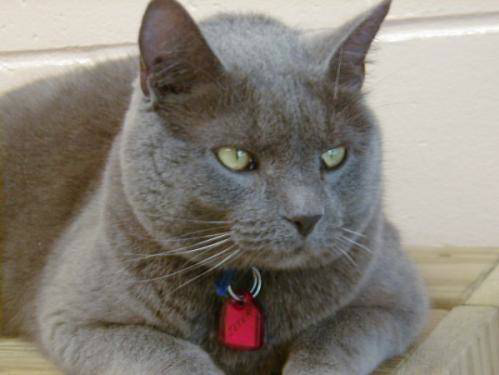

Egyptian_cat, lynx, Siamese_cat, tiger_cat, tabby


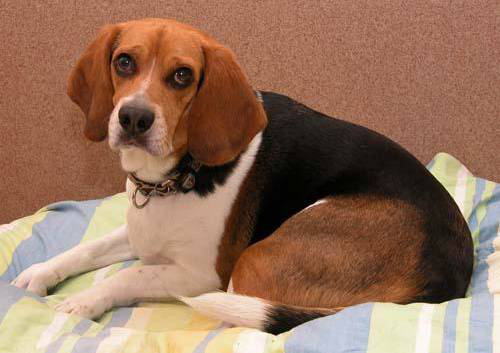

beagle, Walker_hound, English_foxhound, basset, bluetick


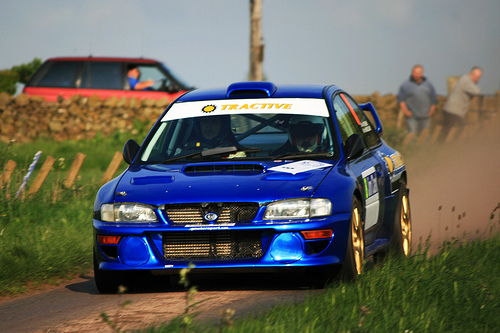

racer, cab, passenger_car, ambulance, police_van


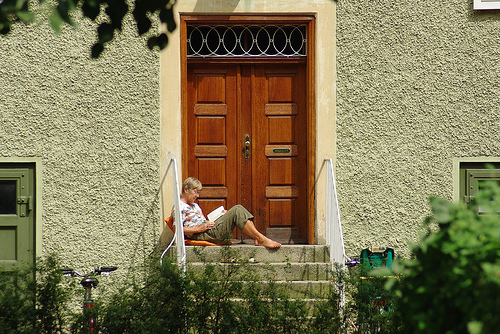

thatch, guillotine, window_screen, monastery, fountain


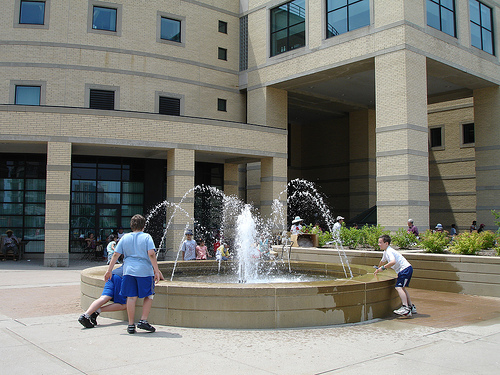

fountain, pedestal, palace, obelisk, triumphal_arch


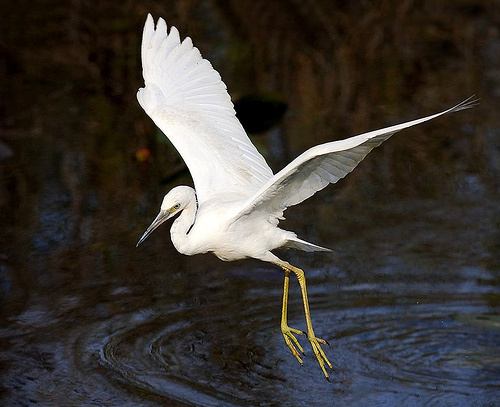

American_egret, crane, spoonbill, little_blue_heron, pelican


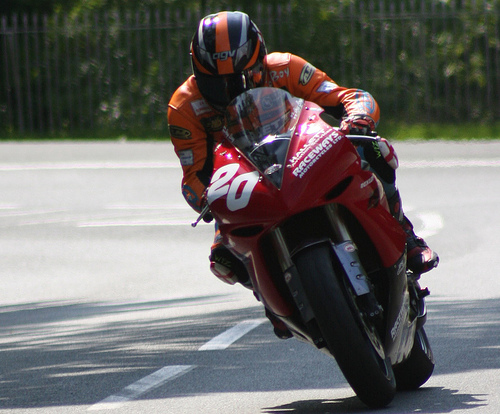

crash_helmet, motor_scooter, snowmobile, moped, bobsled


In [134]:
folder = "Test/imagenet"
list_img = read_images_in_folder(folder,preprocess=preprocess_input)

for img_idx in range(len(list_img[0])):
    decoded = predict_imagenet(list_img[0][img_idx],vgg_full)
    caption = merge_descriptions(decoded[0])
    display_image_and_caption(list_img[1][img_idx],caption)

# Cats vs dogs

## Dataset 

The dataset was part of the [Kaggle Dogs vs Cats](https://www.kaggle.com/c/dogs-vs-cats) challenge.The training set contains 25k images of cats and dogs. We have split this dataset into a training set of 20000, a validation set of 1400 and a test set of 3596 images, with the ratio of labels being close to 1 for each set.

We will stream the images from the directory in batches and apply some preprocessing steps before being inputed to the model. We have a data generator for each training set

In [108]:
# the number of classes
no_classes = 2


# the model input size as defined by VGG16
input_size = (224,224)

# folder for training
folder_train = 'Datasets/cats_dogs_large/Train'
# folder for validation
folder_validation = 'Datasets/cats_dogs_large/Validation'
# folder for testing
folder_test = 'Datasets/cats_dogs_large/Test'

# batch size 
batch_size = 16
    

train_datagen = ImageDataGenerator(shear_range=0.3, 
                                   zoom_range=0.3, 
                                   horizontal_flip=True, 
                                   preprocessing_function=preprocess_input)                                 

train_generator = train_datagen.flow_from_directory(folder_train, 
                                                    batch_size=batch_size,
                                                    shuffle=True, 
                                                    target_size=input_size, 
                                                    class_mode='categorical') 

training_samples = train_generator.n



validation_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

validation_generator = validation_datagen.flow_from_directory(folder_validation, 
                                                        batch_size=batch_size, 
                                                        target_size=input_size, 
                                                        shuffle=False, 
                                                        class_mode='categorical')
validation_samples = validation_generator.n



test_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

test_generator = test_datagen.flow_from_directory(folder_test, 
                                                  batch_size=batch_size, 
                                                  target_size=input_size, 
                                                  shuffle=False, 
                                                  class_mode='categorical')

test_samples = test_generator.n

Found 20001 images belonging to 2 classes.
Found 1401 images belonging to 2 classes.
Found 3596 images belonging to 2 classes.


## Transfer learning

We are going to reuse the feature extractor part of the VGG16 network and replace the classification with our own network custom desinged for 2 classes

In [109]:
def FineTuneVGG16(classes_number,input_shape):  
        # remove classification layers
        base_model = KerasVGG16(weights='imagenet', include_top=False, input_shape=input_shape)

        # add our own classification layers
        x = base_model.output
        x = Flatten()(x)
        x = Dense(512, activation='relu', name='fc1')(x)
        x = Dropout(0.6)(x)
        x = Dense(256, activation='relu', name='fc2')(x)
        x = Dropout(0.6)(x)
        predictions = Dense(classes_number, activation='softmax', name='predictions')(x)

        model = Model(input=base_model.input, output=predictions)
        
        return model


In [110]:
vgg_model = FineTuneVGG16(classes_number=2, input_shape = (224, 224, 3))

print(vgg_model.summary())

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_9 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0         
__________

/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/ipykernel/__main__.py:14: UserWarning: Update your `Model` call to the Keras 2 API: `Model(outputs=Tensor("pr..., inputs=Tensor("in...)`


## Fine tune

We are going to retrain just the classification layers, keeping the VGG16 part fixed. This makes the training much simpler, but it has some draw-backs. The number of parameters we need to fix drops to about half.

In a rigorous setting we would start by fine tunning and afterwards doing an end-to-end retraining. Also the training would be performed one layer at a time, moving from the end layer backwards to the front. To obtain a high accuracy multiple passes would be needed. Also the model we get from Keras does not contain additional training settings (i.e batch normalization, dropout)

In [111]:
def unfreeze_layer_onwards(model, layer_name):
    '''
        This layer unfreezes all layers beyond layer_name
    '''
    trainable = False
    for layer in model.layers:
        try:
            if layer.name == layer_name:
                trainable = True
            layer.trainable = trainable
        except:
            continue
    
    return model
  
# set the first layers up to the last conv block to non-trainable 
unfreeze_layer_onwards(vgg_model,'fc1')

print(vgg_model.summary())

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_9 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0         
__________

## Training

In [113]:
# how many times will will present the full training dataset
epochs= 50

# compile the symbolic link model to the processing graph used for training
vgg_model.compile(loss='categorical_crossentropy',
                  optimizer=Adam(lr=1e-5),
                  metrics=['accuracy'])
    
# use tensorboard for monitoring training

# tensorboard will read from the log folder 
log_dir = 'Models/cats_dogs_large/tensorboard'

tensorboard_callback = TensorBoard(log_dir=log_dir, 
                                   histogram_freq=0, 
                                   batch_size=batch_size, 
                                   write_graph=True, 
                                   embeddings_freq=0, 
                                   embeddings_metadata=None)

# allows monitoring of progress during a long training
file_name = 'Models/cats_dogs_large/checkpoints/weights-improvement-{epoch:02d}-{loss:2.5f}.hdf5'
checkpoint = ModelCheckpoint(file_name, monitor='loss', verbose=1, save_best_only=True, mode='min')


# early stopping to avoid overfitting

early_stopping = EarlyStopping(monitor='val_acc', min_delta=1e-2, patience=5, verbose=1, mode='max')

# perform training    
history_vgg_model = vgg_model.fit_generator(train_generator,
                        steps_per_epoch=training_samples/batch_size,
                        validation_data=validation_generator,
                        validation_steps=validation_samples/batch_size,
                        nb_epoch=epochs,
                        verbose=1,
                        callbacks=[tensorboard_callback, checkpoint, early_stopping])
   
        
  

/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/ipykernel/__main__.py:37: UserWarning: The semantics of the Keras 2 argument `steps_per_epoch` is not the same as the Keras 1 argument `samples_per_epoch`. `steps_per_epoch` is the number of batches to draw from the generator at each epoch. Basically steps_per_epoch = samples_per_epoch/batch_size. Similarly `nb_val_samples`->`validation_steps` and `val_samples`->`steps` arguments have changed. Update your method calls accordingly.
/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/ipykernel/__main__.py:37: UserWarning: Update your `fit_generator` call to the Keras 2 API: `fit_generator(<keras.pre..., callbacks=[<keras.ca..., verbose=1, epochs=50, validation_data=<keras.pre..., validation_steps=87.5625, steps_per_epoch=1250.0625)`


Epoch 1/50
1251/1250 [==============================] - 356s 284ms/step - loss: 2.5562 - acc: 0.7955 - val_loss: 0.2149 - val_acc: 0.9786

Epoch 00001: loss improved from inf to 2.55808, saving model to Models/cats_dogs_large/checkpoints/weights-improvement-01-2.55808.hdf5
Epoch 2/50
1251/1250 [==============================] - 292s 234ms/step - loss: 0.9499 - acc: 0.9197 - val_loss: 0.1548 - val_acc: 0.9872

Epoch 00002: loss improved from 2.55808 to 0.95064, saving model to Models/cats_dogs_large/checkpoints/weights-improvement-02-0.95064.hdf5
Epoch 3/50
1251/1250 [==============================] - 281s 225ms/step - loss: 0.6829 - acc: 0.9410 - val_loss: 0.1422 - val_acc: 0.9864

Epoch 00003: loss improved from 0.95064 to 0.68342, saving model to Models/cats_dogs_large/checkpoints/weights-improvement-03-0.68342.hdf5
Epoch 4/50
1251/1250 [==============================] - 281s 224ms/step - loss: 0.5278 - acc: 0.9530 - val_loss: 0.1250 - val_acc: 0.9843

Epoch 00004: loss improved from

In [114]:
model_save_path = 'Models/cats_dogs_large/final/cats_dogs_large_model.h5'
weights_save_path = 'Models/cats_dogs_large/final/cats_dogs_large_weights.h5'
history_save_path = 'Models/cats_dogs_large/final/cats_dogs_large_history.p'

if not DEMO:
    # Save the final model after training
    vgg_model.save(model_save_path, overwrite=True)
    # Save only the weights of each layer
    vgg_model.save_weights(weights_save_path,overwrite=True)
    
    with open('Models/cats_dogs_large/final/cats_dogs_large_history.p', "wb") as pckl_dump:
        pickle.dump(history_vgg_model.history, pckl_dump) 

In [115]:
vgg_model.load_weights(weights_save_path)
history = pickle.load(open(history_save_path, 'rb'))

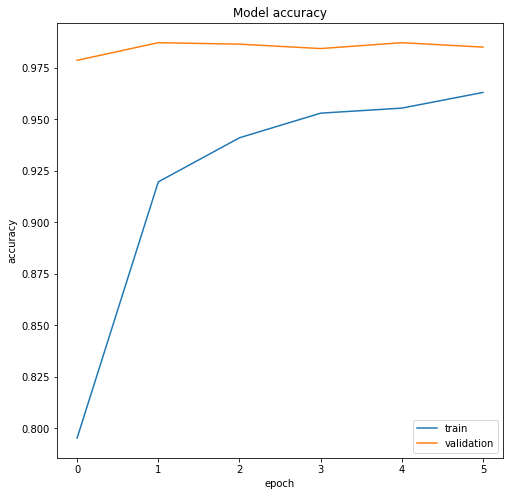

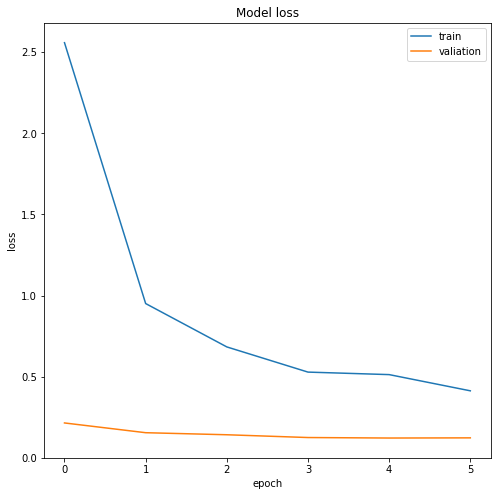

In [116]:

# history for accuracy
plt.figure(figsize=(8, 8)) 
plt.plot(history['acc'])
plt.plot(history['val_acc'])
plt.title('Model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='lower right')
plt.show()

# history for loss
plt.figure(figsize=(8, 8)) 
plt.plot(history['loss'])
plt.plot(history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'valiation'], loc='upper right')
plt.show()

### Evaluate performance  

In [127]:
score = vgg_model.evaluate_generator(test_generator, test_samples/batch_size, pickle_safe=True)

scores = vgg_model.predict_generator(test_generator, test_samples/batch_size)


class_indices = test_generator.class_indices
class_pred = np.argmax(scores,axis=1)

correct = 0
for i, n in enumerate(test_generator.filenames):
    class_name = n[:3]
    if class_indices[class_name] == class_pred[i]:
        correct += 1
    
print("Correct:", correct, " Total: ", len(test_generator.filenames))

print("Loss: ", score[0], "Accuracy: ", score[1])


/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/ipykernel/__main__.py:1: UserWarning: Update your `evaluate_generator` call to the Keras 2 API: `evaluate_generator(<keras.pre..., 224.75, use_multiprocessing=True)`
  if __name__ == '__main__':


Correct: 3517  Total:  3596
Loss:  0.23670875986591644 Accuracy:  0.9780311457174639


### The real test

In [135]:
class_mapping = {v:k for k,v in train_generator.class_indices.items()}

def predict_cats_dogs(img_data, model):
    """ gives us the labels from the softmax output
        
    """
    preds = model.predict(img_data)
    decoded = class_mapping[np.argmax(preds[0])]
    return decoded

100%|██████████| 10/10 [00:00<00:00, 183.53it/s]


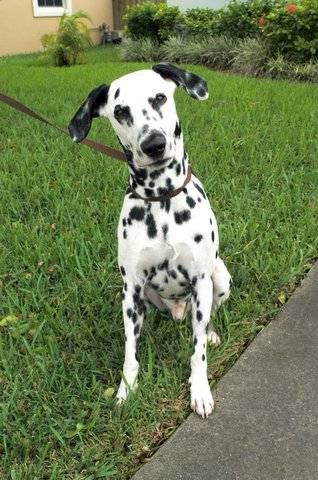

dog


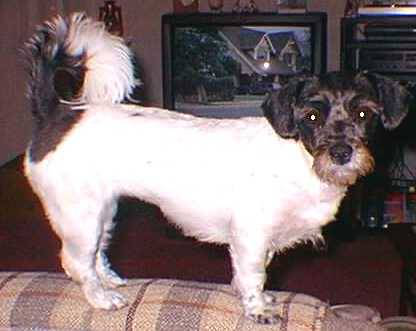

dog


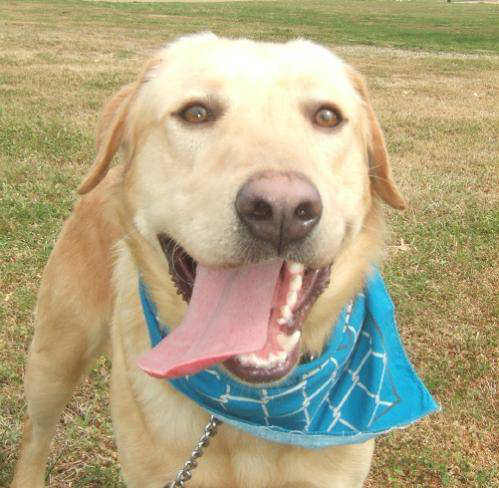

dog


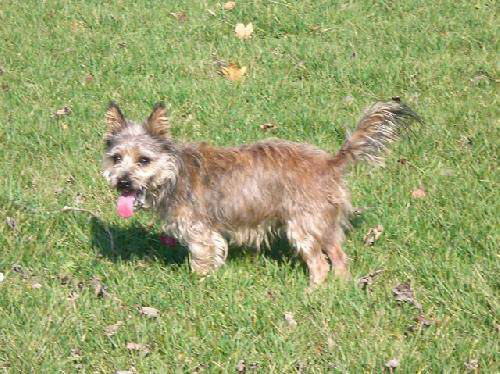

dog


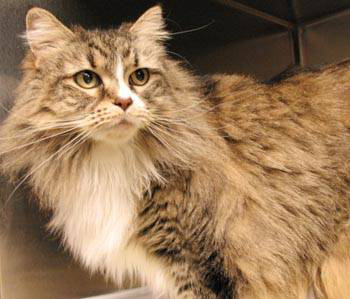

cat


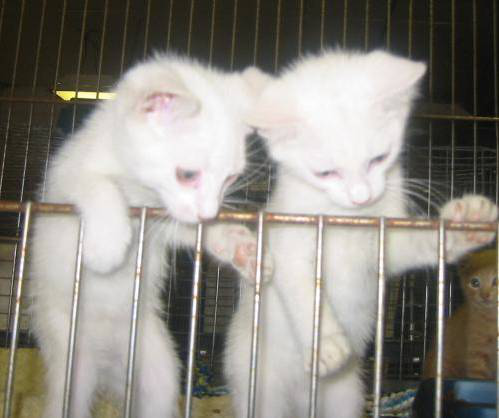

cat


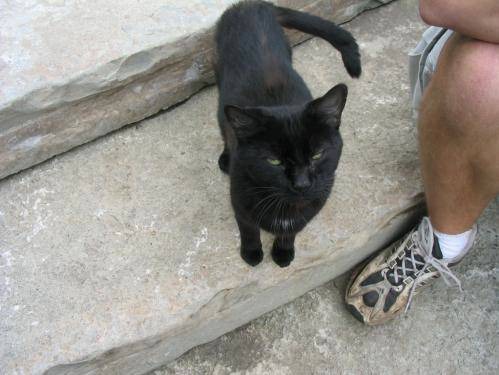

cat


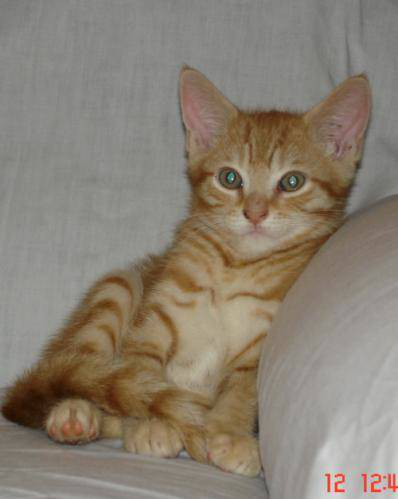

cat


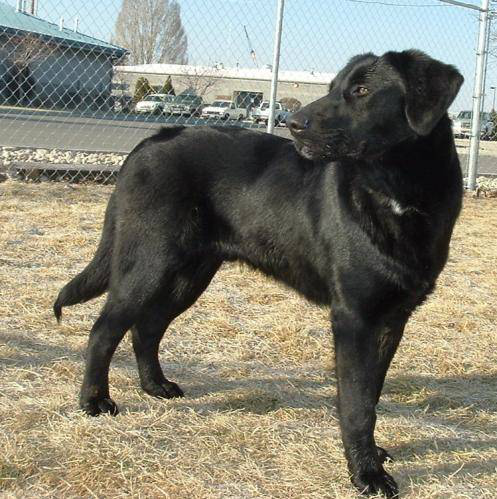

dog


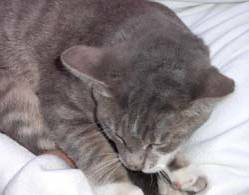

cat


In [136]:
folder = "Test/cats_dogs_large"
list_img = read_images_in_folder(folder,preprocess=preprocess_input)

for img_idx in range(len(list_img[0])):
    decoded = predict_cats_dogs(list_img[0][img_idx],vgg_model)
    display_image_and_caption(list_img[1][img_idx],decoded)

# Training with little data

## Generating dataset

We are going to keep just 0.5% of the training data for both dogs and cats (and also for validation) and see how we can deal with this shortage of data. This will prove the value data has in every deep learning application. 

In [83]:
def copy_random(src,dst,count):
    """ copies count files from src to dest
    """
    list_files = os.listdir(src)
    count = min(count,len(list_files))
    
    os.makedirs(dst, exist_ok=True)
    
    for i in range(count):
        idx = random.randint(0, len(list_files)-1)
        copyfile(os.path.join(src,list_files[idx]), os.path.join(dst,list_files[idx]))
    

In [84]:
percent = 0.005

training_samples = 0.5* (len(os.listdir('Datasets/cats_dogs_large/Train/cat')) 
                    + len(os.listdir('Datasets/cats_dogs_large/Train/dog')))

# copy train data
train_samples_small = int(round(training_samples * percent))
copy_random('Datasets/cats_dogs_large/Train/cat', 'Datasets/cats_dogs_small/Train/cat', train_samples_small)
copy_random('Datasets/cats_dogs_large/Train/dog', 'Datasets/cats_dogs_small/Train/dog', train_samples_small)


validation_samples = 0.5* (len(os.listdir('Datasets/cats_dogs_large/Validation/cat')) 
                    + len(os.listdir('Datasets/cats_dogs_large/Validation/dog')))

# copy validation data
validation_samples_small = int(round(validation_samples*percent))
copy_random('Datasets/cats_dogs_large/Validation/cat', 'Datasets/cats_dogs_small/Validation/cat', validation_samples_small)
copy_random('Datasets/cats_dogs_large/Validation/dog', 'Datasets/cats_dogs_small/Validation/dog', validation_samples_small)

# copy test entirely to be able to compare
copytree('Datasets/cats_dogs_large/Test', 'Datasets/cats_dogs_small/Test')

'Datasets/cats_dogs_small/Test'

## We redo the above steps

In [85]:
# the number of classes
no_classes = 2


# the model input size
input_size = (224,224)

# folder for training
folder_train = 'Datasets/cats_dogs_small/Train'
# folder for validation
folder_validation = 'Datasets/cats_dogs_small/Validation'
# folder for testing
folder_test = 'Datasets/cats_dogs_small/Test'
# batch size 
batch_size = 16
    
    

train_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)                                 

train_generator = train_datagen.flow_from_directory(folder_train, 
                                                    batch_size=batch_size,
                                                    shuffle=True, 
                                                    target_size=input_size, 
                                                    class_mode='categorical') 

training_samples = train_generator.n



validation_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

validation_generator = validation_datagen.flow_from_directory(folder_validation, 
                                                        batch_size=batch_size, 
                                                        target_size=input_size, 
                                                        shuffle=False, 
                                                        class_mode='categorical')
validation_samples = validation_generator.n



test_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

test_generator = test_datagen.flow_from_directory(folder_test, 
                                                  batch_size=batch_size, 
                                                  target_size=input_size, 
                                                  shuffle=False, 
                                                  class_mode='categorical')

test_samples = test_generator.n



Found 100 images belonging to 2 classes.
Found 8 images belonging to 2 classes.
Found 3596 images belonging to 2 classes.


In [86]:
vgg_model_small = FineTuneVGG16(classes_number=2, input_shape = (224, 224, 3))

# set the first layers up to the last conv block to non-trainable 
unfreeze_layer_onwards(vgg_model_small,'fc1')


/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/ipykernel/__main__.py:14: UserWarning: Update your `Model` call to the Keras 2 API: `Model(outputs=Tensor("pr..., inputs=Tensor("in...)`


In [92]:
# how many times will will present the full training dataset
epochs= 50

# compile the symbolic link model to the processing graph used for training
vgg_model_small.compile(loss='categorical_crossentropy',
                  optimizer=Adam(lr=1e-5),
                  metrics=['accuracy'])
    
# use tensorboard for monitoring training

# tensorboard will read from the log folder 
log_dir = 'Models/cats_dogs_small/tensorboard'

tensorboard_callback = TensorBoard(log_dir=log_dir, 
                                   histogram_freq=0, 
                                   batch_size=batch_size, 
                                   write_graph=True, 
                                   embeddings_freq=0, 
                                   embeddings_metadata=None)

# allows monitoring of progress during a long training
file_name = 'Models/cats_dogs_small/checkpoints/weights-improvement-{epoch:02d}-{loss:2.5f}.hdf5'
checkpoint = ModelCheckpoint(file_name, monitor='loss', verbose=1, save_best_only=True, mode='min')


# early stopping to avoid overfitting

early_stopping = EarlyStopping(monitor='val_acc', min_delta=1e-2, patience=5, verbose=1, mode='max')

# perform training    
history_vgg_model = vgg_model_small.fit_generator(train_generator,
                        steps_per_epoch=training_samples/batch_size,
                        validation_data=validation_generator,
                        validation_steps=validation_samples/batch_size,
                        nb_epoch=epochs,
                        verbose=1,
                        callbacks=[tensorboard_callback, checkpoint, early_stopping])
      



/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/ipykernel/__main__.py:37: UserWarning: The semantics of the Keras 2 argument `steps_per_epoch` is not the same as the Keras 1 argument `samples_per_epoch`. `steps_per_epoch` is the number of batches to draw from the generator at each epoch. Basically steps_per_epoch = samples_per_epoch/batch_size. Similarly `nb_val_samples`->`validation_steps` and `val_samples`->`steps` arguments have changed. Update your method calls accordingly.
/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/ipykernel/__main__.py:37: UserWarning: Update your `fit_generator` call to the Keras 2 API: `fit_generator(<keras.pre..., callbacks=[<keras.ca..., verbose=1, epochs=50, validation_data=<keras.pre..., validation_steps=0.5, steps_per_epoch=6.25)`


Epoch 1/50
7/6 [=================================] - 1s 186ms/step - loss: 4.3377 - acc: 0.6775 - val_loss: 2.2055 - val_acc: 0.7500

Epoch 00001: loss improved from inf to 4.61953, saving model to Models/cats_dogs_small/checkpoints/weights-improvement-01-4.61953.hdf5
Epoch 2/50
7/6 [=================================] - 1s 143ms/step - loss: 4.3489 - acc: 0.6956 - val_loss: 2.1481 - val_acc: 0.8750

Epoch 00002: loss improved from 4.61953 to 4.38197, saving model to Models/cats_dogs_small/checkpoints/weights-improvement-02-4.38197.hdf5
Epoch 3/50
7/6 [=================================] - 1s 132ms/step - loss: 2.7598 - acc: 0.7681 - val_loss: 2.1209 - val_acc: 0.8750

Epoch 00003: loss improved from 4.38197 to 3.00210, saving model to Models/cats_dogs_small/checkpoints/weights-improvement-03-3.00210.hdf5
Epoch 4/50
7/6 [=================================] - 1s 149ms/step - loss: 4.5396 - acc: 0.6994 - val_loss: 2.1220 - val_acc: 0.7500

Epoch 00004: loss did not improve from 3.00210
Epoc

In [137]:
model_save_path = 'Models/cats_dogs_small/final/cats_dogs_small_model.h5'
weights_save_path = 'Models/cats_dogs_small/final/cats_dogs_small_weights.h5'
history_save_path = 'Models/cats_dogs_small/final/cats_dogs_small_history.p'

if not DEMO:
    # Save the final model after training
    vgg_model_small.save(model_save_path, overwrite=True)
    # Save only the weights of each layer
    vgg_model_small.save_weights(weights_save_path,overwrite=True)
    
    with open(history_save_path, "wb") as pckl_dump:
        pickle.dump(history_vgg_model.history, pckl_dump) 

In [138]:
vgg_model_small.load_weights(weights_save_path)
history = pickle.load(open(history_save_path, 'rb'))

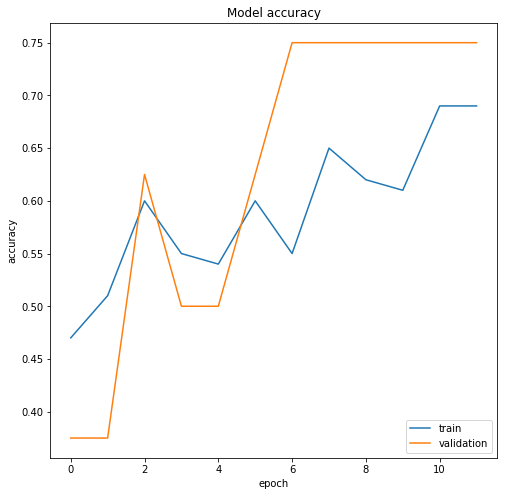

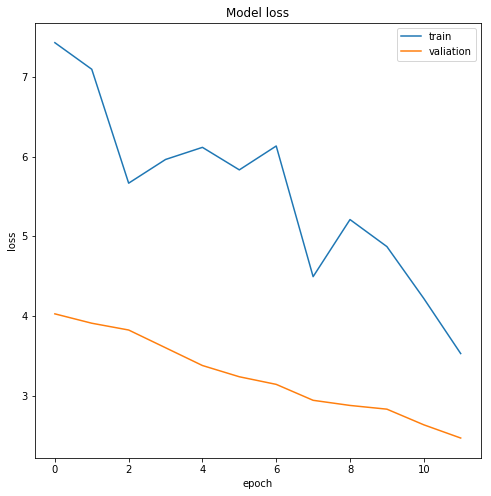

In [90]:
# history for accuracy
plt.figure(figsize=(8, 8)) 
plt.plot(history['acc'])
plt.plot(history['val_acc'])
plt.title('Model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='lower right')
plt.show()

# history for loss
plt.figure(figsize=(8, 8)) 
plt.plot(history['loss'])
plt.plot(history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'valiation'], loc='upper right')
plt.show()

In [139]:
score = vgg_model_small.evaluate_generator(test_generator, test_samples/batch_size, pickle_safe=True)

scores = vgg_model_small.predict_generator(test_generator, test_samples/batch_size)

class_indices = test_generator.class_indices
class_pred = np.argmax(scores,axis=1)

correct = 0
for i, n in enumerate(test_generator.filenames):
    class_name = n[:3]
    if class_indices[class_name] == class_pred[i]:
        correct += 1
    
print("Correct:", correct, " Total: ", len(test_generator.filenames))

print("Loss: ", score[0], "Accuracy: ", score[1])

/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/ipykernel/__main__.py:1: UserWarning: Update your `evaluate_generator` call to the Keras 2 API: `evaluate_generator(<keras.pre..., 224.75, use_multiprocessing=True)`
  if __name__ == '__main__':


Correct: 2888  Total:  3596
Loss:  1.7146242760708172 Accuracy:  0.8031145717132343


100%|██████████| 10/10 [00:00<00:00, 157.60it/s]


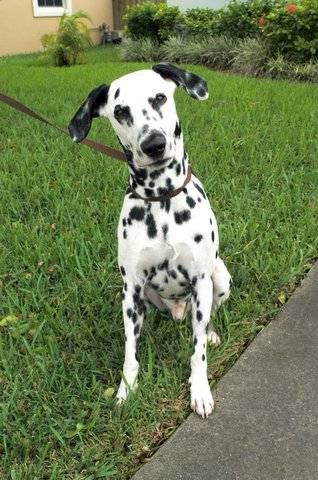

dog


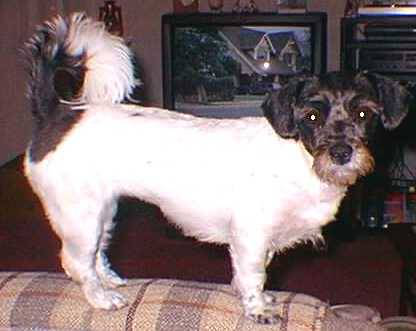

dog


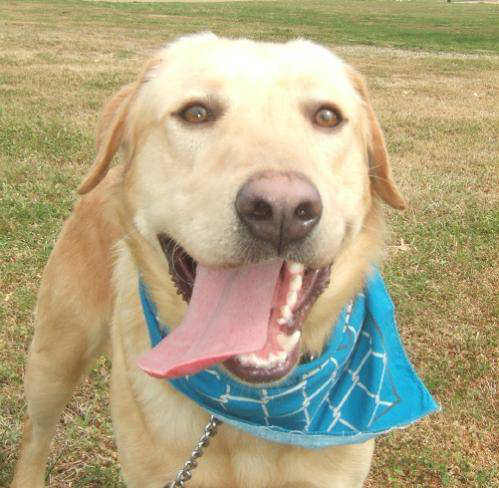

dog


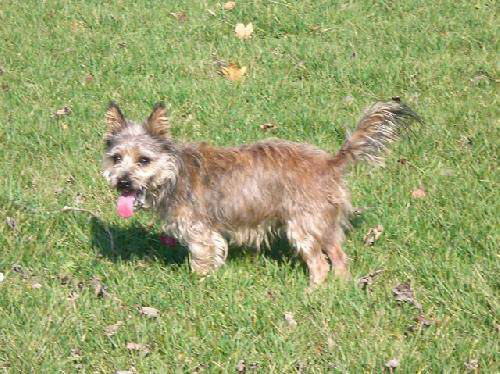

cat


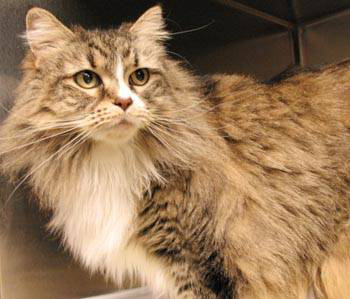

cat


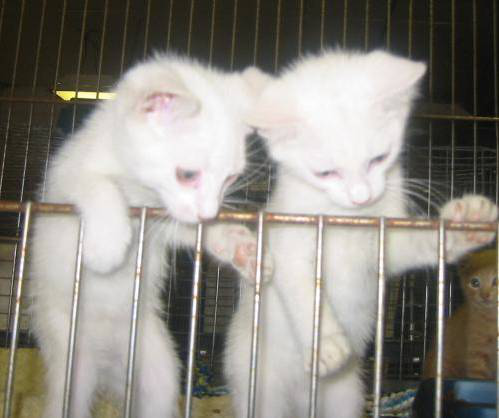

dog


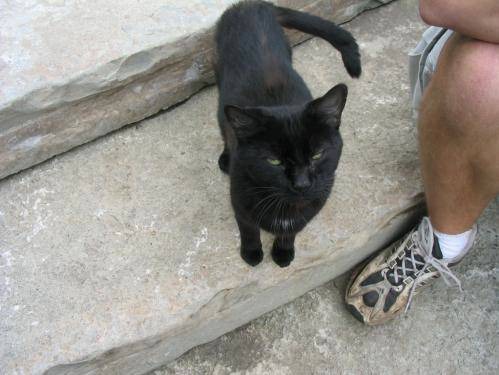

dog


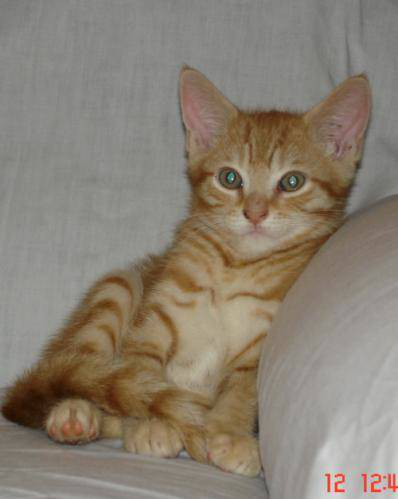

cat


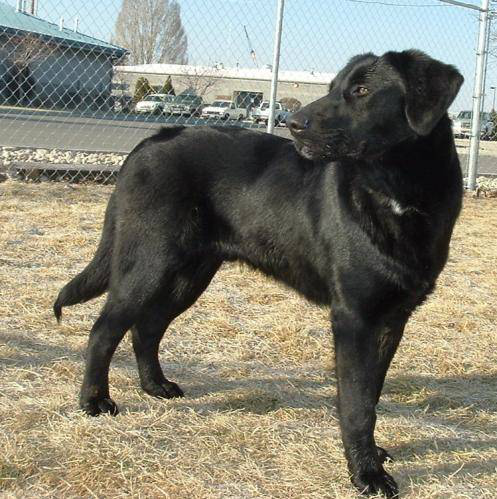

dog


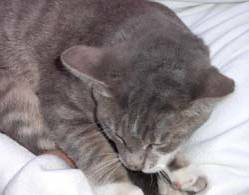

cat


In [94]:
folder = "Test/cats_dogs_large"
list_img = read_images_in_folder(folder,preprocess=preprocess_input)

for img_idx in range(len(list_img[0])):
    decoded = predict_cats_dogs(list_img[0][img_idx],vgg_model_small)
    display_image_and_caption(list_img[1][img_idx],decoded)

# Data augmentation

To augment the training data we could try to get more samples, but this could be a hard and long process or it might also not be possible.

The alternative is to try to alter our dataset to obtain new examples. This process is called data augmentation. For images this accounts for applying geometrical transformations or other image processing techniques to obtain a new input image that has the same label. Special care needs to be taken when augmenting data as not all transformations will produce a valid dataset. In an application were we would be searching to distinguish between a rectangle and square, warping the training images would not produce a valid augmented dataset.

Sometimes it can also be the case that we have a small amount of labeled data and lots of unlabeled data. We can try to use the known labels to infer the labels for the huge amount of data that without this sits unused. We will not explore this form of semi-supervised data augmentation  here.

This shows us the value of data and that in the era of deep learning data is power.



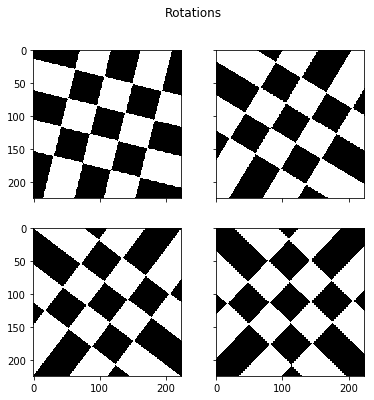

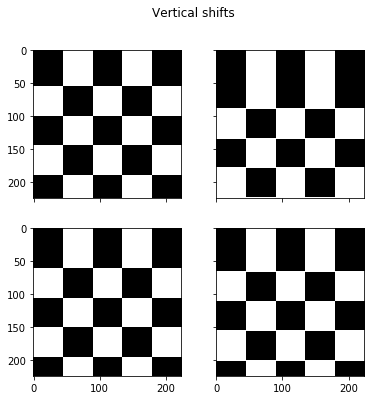

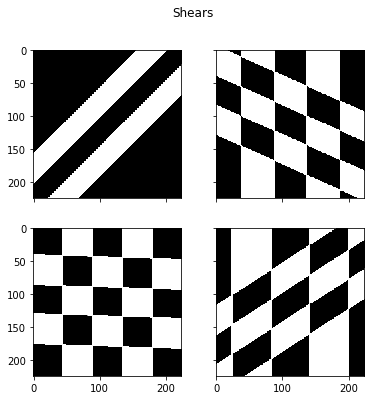

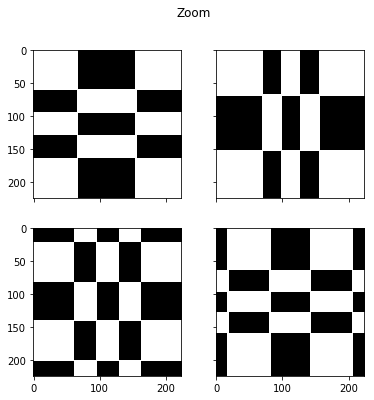

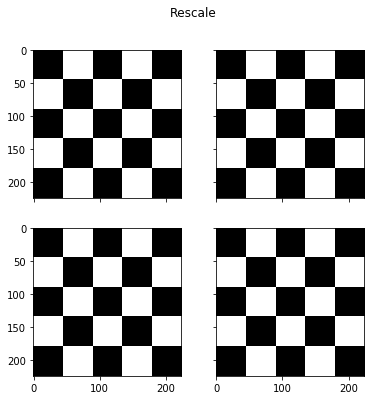

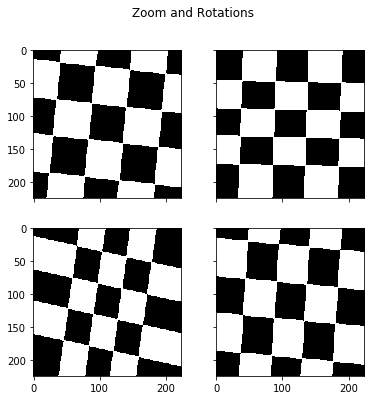

In [96]:
target_size = (224,224)

full_path = 'Presentation/misc/checkerboard.png'

img_aug = image.load_img(full_path, target_size=target_size)
img_data = image.img_to_array(img_aug)
img_data = np.expand_dims(img_data, axis=0)

augmentation_list = [(ImageDataGenerator(rotation_range=90),"Rotations"),
                    (ImageDataGenerator(height_shift_range=0.2),"Vertical shifts"),
                    (ImageDataGenerator(shear_range=90),"Shears"),
                    (ImageDataGenerator(zoom_range=0.6),"Zoom"),
                    (ImageDataGenerator(rescale=2),"Rescale"),
                    (ImageDataGenerator(zoom_range=0.3,rotation_range=10,),"Zoom and Rotations")]


for (aug,name) in augmentation_list:
    aug.fit(img_data)
    samples = aug.flow(img_data,batch_size=4)
    
    f, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, sharex='col', sharey='row',figsize=(6,6))
    f.suptitle(name, fontsize=12)
    ax1.imshow(np.clip(np.squeeze(samples[0]),0,1))
    ax2.imshow(np.clip(np.squeeze(samples[0]),0,1))
    ax3.imshow(np.clip(np.squeeze(samples[0]),0,1))
    ax4.imshow(np.clip(np.squeeze(samples[0]),0,1))
    plt.show()
    



## We redo the above steps

In [3]:
# the number of classes
no_classes = 2


# the model input size
input_size = (224,224)

# folder for training
folder_train = 'Datasets/cats_dogs_small/Train'
# folder for validation
folder_validation = 'Datasets/cats_dogs_small/Validation'
# folder for testing
folder_test = 'Datasets/cats_dogs_small/Test'
# batch size 
batch_size = 16
    
    
train_datagen = ImageDataGenerator(rotation_range=45,
                                   height_shift_range=0.2,
                                   shear_range=0.3,
                                   zoom_range=0.2,
                                   horizontal_flip=True, 
                                   preprocessing_function=preprocess_input)                                 

train_generator = train_datagen.flow_from_directory(folder_train, 
                                                    batch_size=batch_size,
                                                    shuffle=True, 
                                                    target_size=input_size, 
                                                    class_mode='categorical') 

training_samples = train_generator.n



validation_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

validation_generator = validation_datagen.flow_from_directory(folder_validation, 
                                                        batch_size=batch_size, 
                                                        target_size=input_size, 
                                                        shuffle=False, 
                                                        class_mode='categorical')
validation_samples = validation_generator.n



test_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

test_generator = test_datagen.flow_from_directory(folder_test, 
                                                  batch_size=batch_size, 
                                                  target_size=input_size, 
                                                  shuffle=False, 
                                                  class_mode='categorical')

test_samples = test_generator.n



Found 100 images belonging to 2 classes.
Found 8 images belonging to 2 classes.
Found 3596 images belonging to 2 classes.


Found 100 images belonging to 2 classes.
(224, 224, 3)


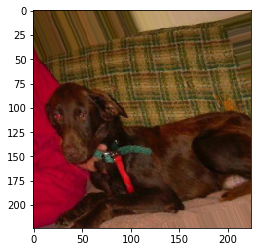

(224, 224, 3)


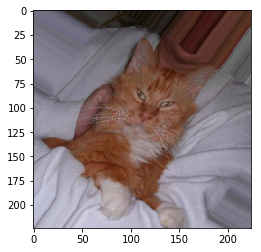

(224, 224, 3)


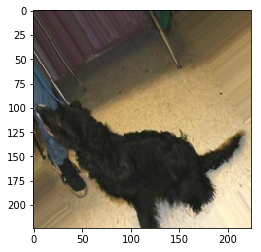

(224, 224, 3)


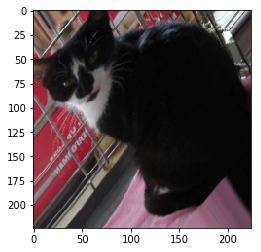

(224, 224, 3)


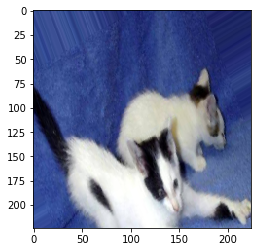

(224, 224, 3)


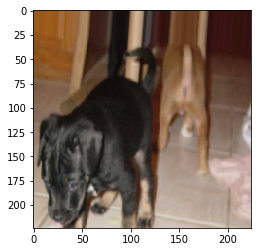

(224, 224, 3)


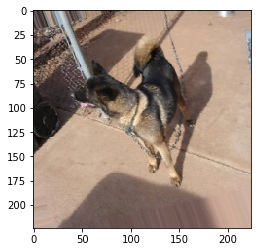

(224, 224, 3)


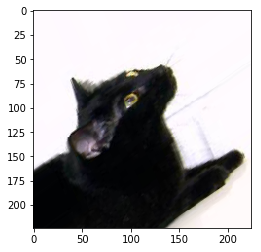

(224, 224, 3)


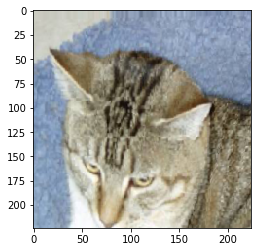

(224, 224, 3)


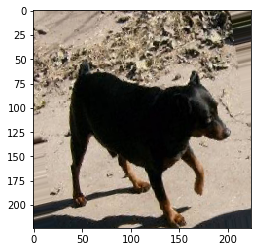

(224, 224, 3)


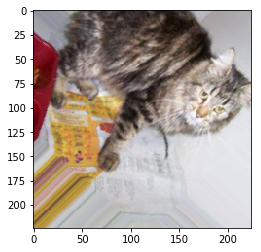

(224, 224, 3)


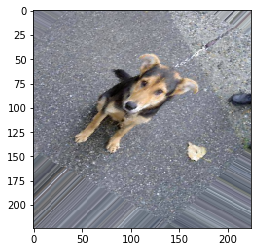

(224, 224, 3)


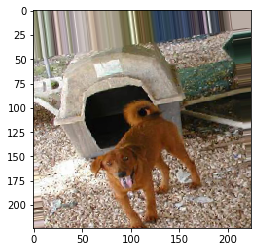

(224, 224, 3)


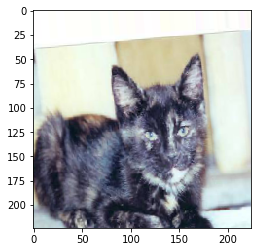

(224, 224, 3)


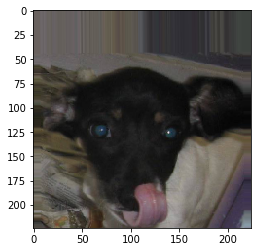

(224, 224, 3)


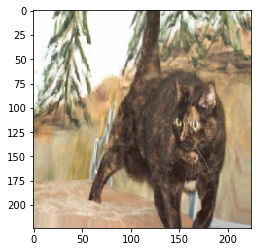

In [8]:
train_datagen_demo = ImageDataGenerator(rotation_range=45,
                                   height_shift_range=0.2,
                                   shear_range=0.3,
                                   zoom_range=0.2,
                                   horizontal_flip=True,
                                   rescale=(1/255)) 
                                   # preprocessing_function=preprocess_input - removes the mean                                 

train_generator_demo = train_datagen_demo.flow_from_directory(folder_train, 
                                                    batch_size=batch_size,
                                                    shuffle=True, 
                                                    target_size=input_size, 
                                                    class_mode='categorical')

x,y = next(train_generator_demo)
for i in range(len(x)):
    image_trans = x[i]
    print(image_trans.shape)
    plt.imshow(image_trans)
    plt.show()

In [99]:
vgg_model_small = FineTuneVGG16(classes_number=2, input_shape = (224, 224, 3))

# set the first layers up to the last conv block to non-trainable 
unfreeze_layer_onwards(vgg_model_small,'fc1')

/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/ipykernel/__main__.py:14: UserWarning: Update your `Model` call to the Keras 2 API: `Model(outputs=Tensor("pr..., inputs=Tensor("in...)`


In [101]:
# how many times will will present the full training dataset
epochs= 50

# compile the symbolic link model to the processing graph used for training
vgg_model_small.compile(loss='categorical_crossentropy',
                  optimizer=Adam(lr=1e-5),
                  metrics=['accuracy'])
    
# use tensorboard for monitoring training

# tensorboard will read from the log folder 
log_dir = 'Models/cats_dogs_small_augmented/tensorboard'

tensorboard_callback = TensorBoard(log_dir=log_dir, 
                                   histogram_freq=0, 
                                   batch_size=batch_size, 
                                   write_graph=True, 
                                   embeddings_freq=0, 
                                   embeddings_metadata=None)

# allows monitoring of progress during a long training
file_name = 'Models/cats_dogs_small_augmented/checkpoints/weights-improvement-{epoch:02d}-{loss:2.5f}.hdf5'
checkpoint = ModelCheckpoint(file_name, monitor='loss', verbose=1, save_best_only=True, mode='min')


# early stopping to avoid overfitting

early_stopping = EarlyStopping(monitor='val_acc', min_delta=1e-2, patience=5, verbose=1, mode='max')

# perform training    
history_vgg_model = vgg_model_small.fit_generator(train_generator,
                        steps_per_epoch=training_samples/batch_size,
                        validation_data=validation_generator,
                        validation_steps=validation_samples/batch_size,
                        nb_epoch=epochs,
                        verbose=1,
                        callbacks=[tensorboard_callback, checkpoint, early_stopping])
      

/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/ipykernel/__main__.py:37: UserWarning: The semantics of the Keras 2 argument `steps_per_epoch` is not the same as the Keras 1 argument `samples_per_epoch`. `steps_per_epoch` is the number of batches to draw from the generator at each epoch. Basically steps_per_epoch = samples_per_epoch/batch_size. Similarly `nb_val_samples`->`validation_steps` and `val_samples`->`steps` arguments have changed. Update your method calls accordingly.
/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/ipykernel/__main__.py:37: UserWarning: Update your `fit_generator` call to the Keras 2 API: `fit_generator(<keras.pre..., callbacks=[<keras.ca..., verbose=1, epochs=50, validation_data=<keras.pre..., validation_steps=0.5, steps_per_epoch=6.25)`


Epoch 1/50
7/6 [=================================] - 2s 238ms/step - loss: 4.5305 - acc: 0.6466 - val_loss: 5.9973 - val_acc: 0.3750

Epoch 00001: loss improved from inf to 4.99917, saving model to Models/cats_dogs_small_augmented/checkpoints/weights-improvement-01-4.99917.hdf5
Epoch 2/50
7/6 [=================================] - 1s 148ms/step - loss: 7.0518 - acc: 0.5181 - val_loss: 5.7809 - val_acc: 0.5000

Epoch 00002: loss did not improve from 4.99917
Epoch 3/50
7/6 [=================================] - 1s 201ms/step - loss: 5.9364 - acc: 0.5325 - val_loss: 5.5875 - val_acc: 0.5000

Epoch 00003: loss did not improve from 4.99917
Epoch 4/50
7/6 [=================================] - 1s 200ms/step - loss: 5.8952 - acc: 0.5506 - val_loss: 5.2144 - val_acc: 0.5000

Epoch 00004: loss did not improve from 4.99917
Epoch 5/50
7/6 [=================================] - 1s 196ms/step - loss: 6.9311 - acc: 0.4584 - val_loss: 4.8266 - val_acc: 0.5000

Epoch 00005: loss did not improve from 4.999

In [140]:
model_save_path = 'Models/cats_dogs_small_augmented/final/cats_dogs_small_augmented_model.h5'
weights_save_path = 'Models/cats_dogs_small_augmented/final/cats_dogs_small_augmented_weights.h5'
history_save_path = 'Models/cats_dogs_small_augmented/final/cats_dogs_small_augmented_history.p'

if not DEMO:
    # Save the final model after training
    vgg_model_small.save(model_save_path, overwrite=True)
    # Save only the weights of each layer
    vgg_model_small.save_weights(weights_save_path,overwrite=True)
    
    with open(history_save_path, "wb") as pckl_dump:
        pickle.dump(history_vgg_model.history, pckl_dump) 

In [141]:
vgg_model_small.load_weights(weights_save_path)
history = pickle.load(open(history_save_path, 'rb'))

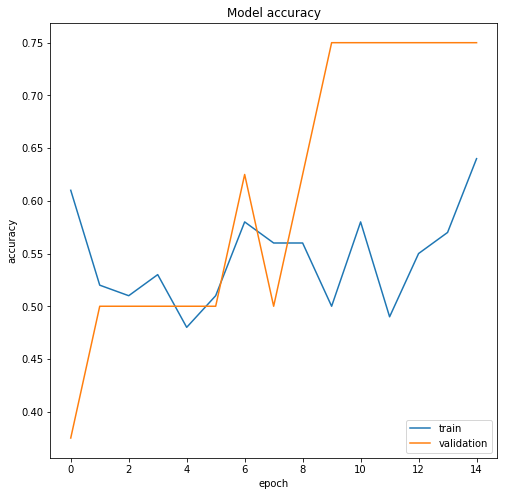

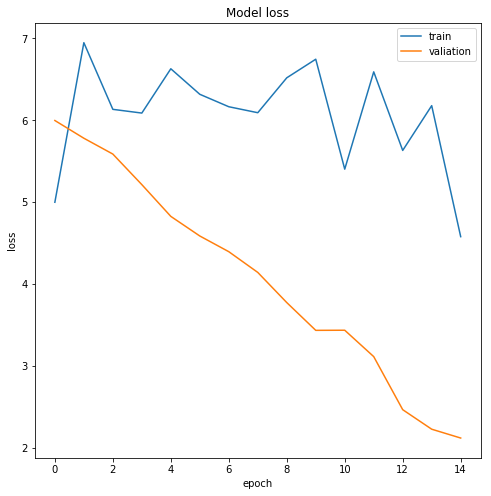

In [106]:
# history for accuracy
plt.figure(figsize=(8, 8)) 
plt.plot(history['acc'])
plt.plot(history['val_acc'])
plt.title('Model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='lower right')
plt.show()

# history for loss
plt.figure(figsize=(8, 8)) 
plt.plot(history['loss'])
plt.plot(history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'valiation'], loc='upper right')
plt.show()

In [142]:
score = vgg_model_small.evaluate_generator(test_generator, test_samples/batch_size, pickle_safe=True)

scores = vgg_model_small.predict_generator(test_generator, test_samples/batch_size)


class_indices = test_generator.class_indices
class_pred = np.argmax(scores,axis=1)

correct = 0
for i, n in enumerate(test_generator.filenames):
    class_name = n[:3]
    if class_indices[class_name] == class_pred[i]:
        correct += 1
    
print("Correct:", correct, " Total: ", len(test_generator.filenames))

print("Loss: ", score[0], "Accuracy: ", score[1])

/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/ipykernel/__main__.py:1: UserWarning: Update your `evaluate_generator` call to the Keras 2 API: `evaluate_generator(<keras.pre..., 224.75, use_multiprocessing=True)`
  if __name__ == '__main__':


Correct: 2748  Total:  3596
Loss:  1.9313989352191165 Accuracy:  0.764182424982875


100%|██████████| 10/10 [00:00<00:00, 186.34it/s]


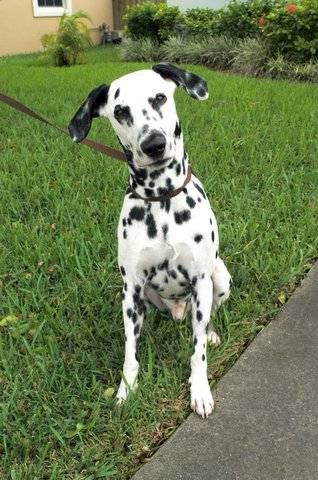

dog


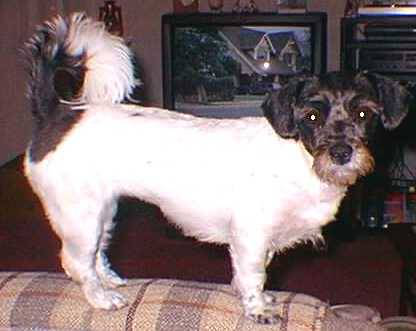

dog


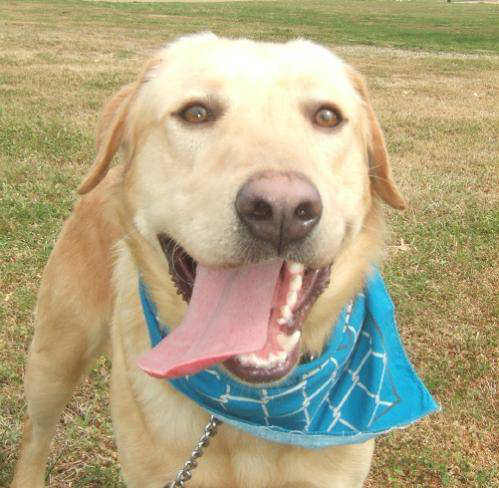

dog


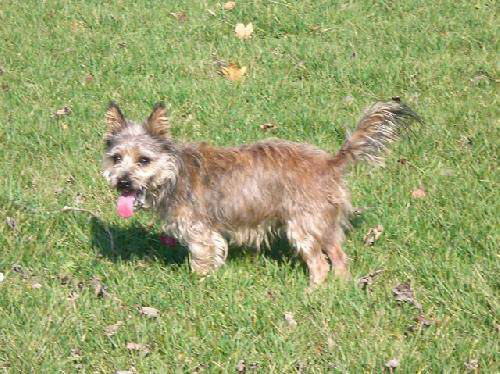

dog


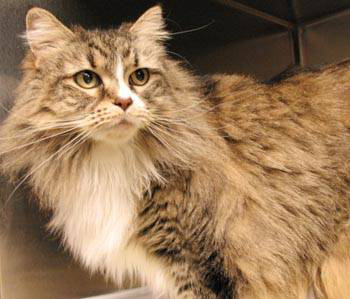

cat


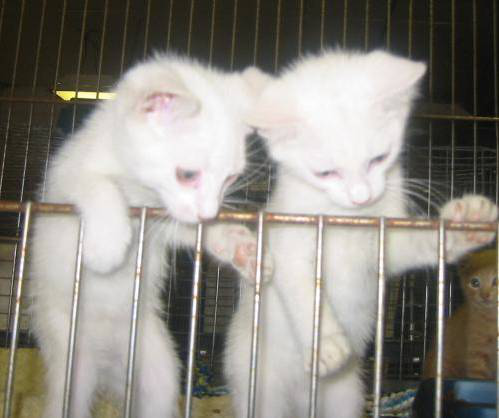

cat


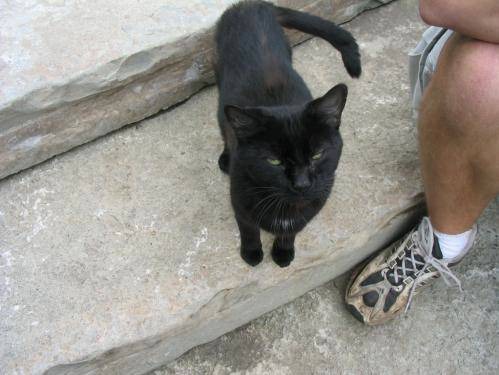

dog


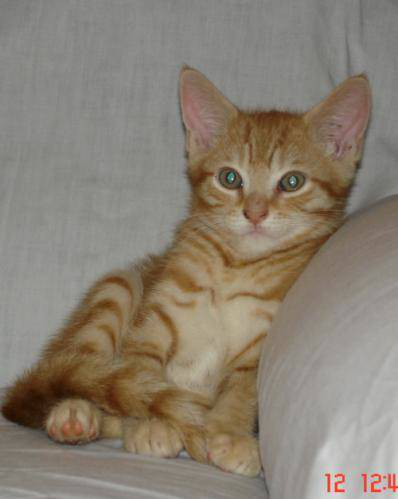

cat


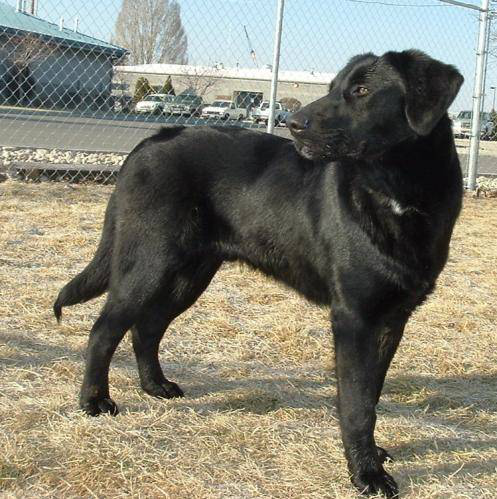

dog


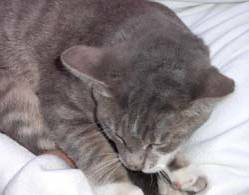

cat


In [107]:
folder = "Test/cats_dogs_large"
list_img = read_images_in_folder(folder,preprocess=preprocess_input)

for img_idx in range(len(list_img[0])):
    decoded = predict_cats_dogs(list_img[0][img_idx],vgg_model_small)
    display_image_and_caption(list_img[1][img_idx],decoded)

In [8]:
# vgg_model_small = None
# for i in range(5):
#     gc.collect()
# K.clear_session()

# An abstract example

Let us define our concept of what we consider a picture posted by someone to be nice to look at. If it is a picture of a landscape or a nice building or a place, we would like to see that. However, if it is a picture of him with possible some friends having a beer in their hands somewhere in Barcelona, it does not make it very interesting. The first category we call it __scenery__ and the second one __person__

We could could also define this concept by the focus (goal) of the picture. If it is a person or something else. If the picture shows the person from a far distance it means that, yes _I want you to see where I was_, but you will actually focus on the details of the background before moving on to the person.

I also developed the idea if that in any quarter of the image there is a person then it should be labeled as __person__.

### The bottom line is that this is a very abstract concept and we want to see how much a model can abstract from just a few examples

## Dataset 

I have went through the [Flickr 8k](https://forms.illinois.edu/sec/1713398) dataset and manually selected this two categories. It was not an easy job and sometimes I had difficulties in actually assigning a category. This was a long and painfull process, but it shows again the value of data.

In [9]:
def select_random(src,label,count):
    """ select count random files from folder
    """
    list_files = os.listdir(src)
    count = min(count,len(list_files))
    
    for i in range(count):
        idx = random.randint(0, len(list_files)-1)
        display_image_and_caption(os.path.join(src,list_files[idx]), label)

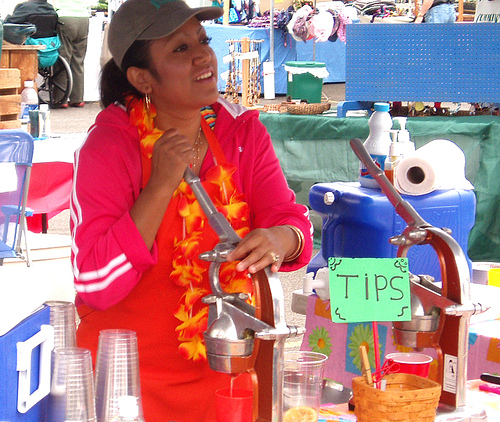

person


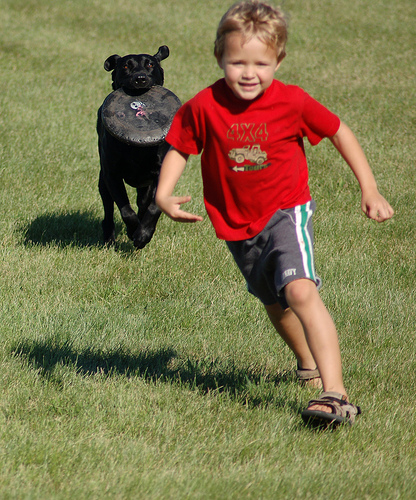

person


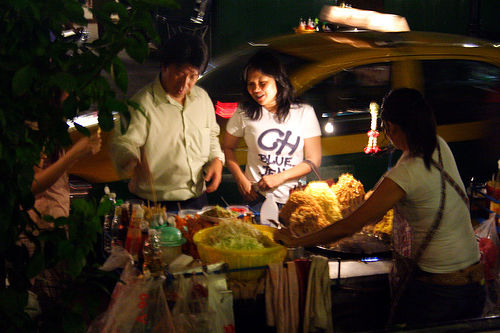

person


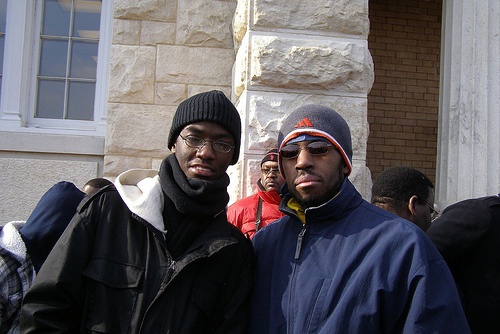

person


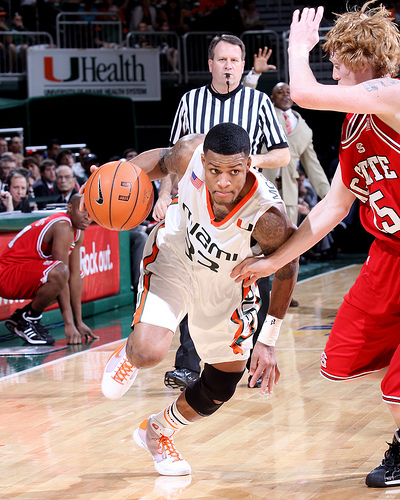

person


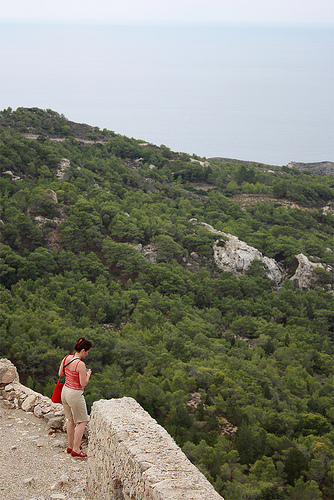

scenery


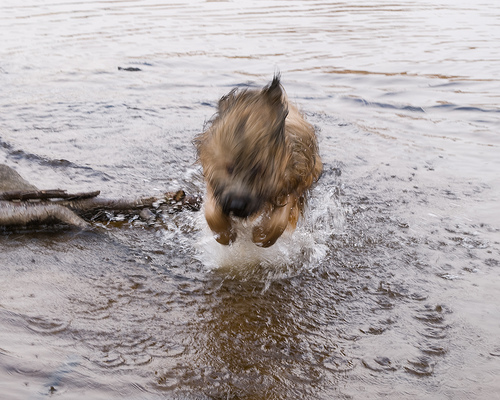

scenery


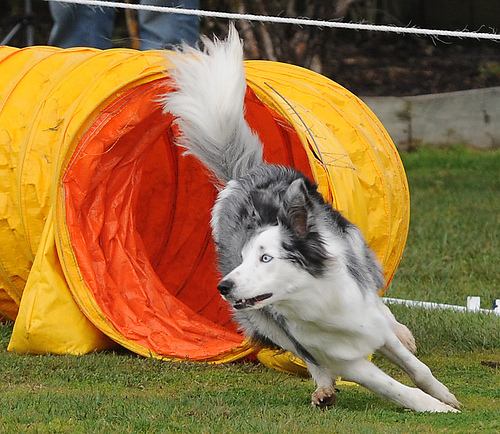

scenery


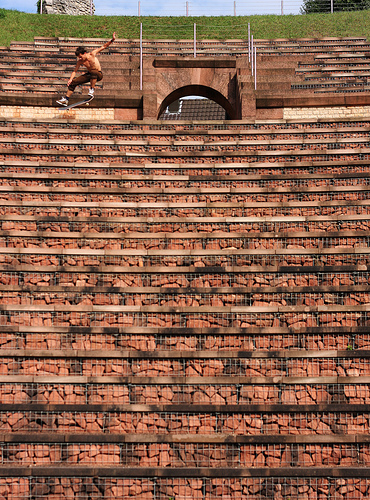

scenery


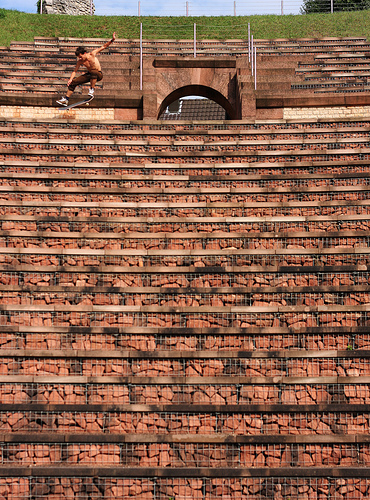

scenery


In [10]:
person_folder = 'Datasets/abstract_classification/Train/person'
scenery_folder = 'Datasets/abstract_classification/Train/scenery'

select_random(person_folder,"person",5)
select_random(scenery_folder,"scenery",5)

In [19]:
# the number of classes
no_classes = 2


# the model input size
input_size = (224,224)

# folder for training
folder_train = 'Datasets/abstract_classification/Train'
# folder for validation
folder_validation = 'Datasets/abstract_classification/Test'
# batch size 
batch_size = 16
    
train_datagen = ImageDataGenerator(shear_range=0.3,                                    
                                   horizontal_flip=True,
                                   rotation_range=45,
                                   height_shift_range=0.2,                                                    
                                   preprocessing_function=preprocess_input)                                 

# zoom_range would affect the dataset, making a person the focus or not

train_generator = train_datagen.flow_from_directory(folder_train, 
                                                    batch_size=batch_size,
                                                    shuffle=True, 
                                                    target_size=input_size, 
                                                    class_mode='categorical')     

                               

train_datagen = ImageDataGenerator(preprocessing_function=preprocess_input,
                                                    rotation_range=45,
                                                    height_shift_range=0.2,
                                                    shear_range=10,                                                    
                                                    horizontal_flip=True)
                                                    


training_samples = train_generator.n



validation_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

validation_generator = validation_datagen.flow_from_directory(folder_validation, 
                                                        batch_size=batch_size, 
                                                        target_size=input_size, 
                                                        shuffle=False, 
                                                        class_mode='categorical')
validation_samples = validation_generator.n


Found 1077 images belonging to 2 classes.
Found 279 images belonging to 2 classes.


In [23]:
abstract_model = FineTuneVGG16(classes_number=2, input_shape = (224, 224, 3))

# set the first layers up to the last conv block to non-trainable 
unfreeze_layer_onwards(abstract_model,'fc1')

/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/ipykernel/__main__.py:14: UserWarning: Update your `Model` call to the Keras 2 API: `Model(outputs=Tensor("pr..., inputs=Tensor("in...)`


In [24]:
# how many times will will present the full training dataset
epochs= 50

# compile the symbolic link model to the processing graph used for training
abstract_model.compile(loss='categorical_crossentropy',
                  optimizer=Adam(lr=1e-5),
                  metrics=['accuracy'])
    
# use tensorboard for monitoring training

# tensorboard will read from the log folder 
log_dir = 'Models/abstract_classification/tensorboard'

tensorboard_callback = TensorBoard(log_dir=log_dir, 
                                   histogram_freq=0, 
                                   batch_size=batch_size, 
                                   write_graph=True, 
                                   embeddings_freq=0, 
                                   embeddings_metadata=None)

# allows monitoring of progress during a long training
file_name = 'Models/abstract_classification/checkpoints/weights-improvement-{epoch:02d}-{loss:2.5f}.hdf5'
checkpoint = ModelCheckpoint(file_name, monitor='loss', verbose=1, save_best_only=True, mode='min')


# early stopping to avoid overfitting

early_stopping = EarlyStopping(monitor='loss', min_delta=1e-3, patience=5, verbose=1, mode='min')

# perform training    
history_abstract_model = abstract_model.fit_generator(train_generator,
                        steps_per_epoch=training_samples/batch_size,
                        validation_data=validation_generator,
                        validation_steps=validation_samples/batch_size,
                        nb_epoch=epochs,
                        verbose=1,
                        callbacks=[tensorboard_callback, checkpoint, early_stopping])
      

/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/ipykernel/__main__.py:37: UserWarning: The semantics of the Keras 2 argument `steps_per_epoch` is not the same as the Keras 1 argument `samples_per_epoch`. `steps_per_epoch` is the number of batches to draw from the generator at each epoch. Basically steps_per_epoch = samples_per_epoch/batch_size. Similarly `nb_val_samples`->`validation_steps` and `val_samples`->`steps` arguments have changed. Update your method calls accordingly.
/home/sylwia/anaconda3/envs/craiova-meetup3/lib/python3.4/site-packages/ipykernel/__main__.py:37: UserWarning: Update your `fit_generator` call to the Keras 2 API: `fit_generator(<keras.pre..., callbacks=[<keras.ca..., verbose=1, epochs=50, validation_data=<keras.pre..., validation_steps=17.4375, steps_per_epoch=67.3125)`


Epoch 1/50
68/67 [==============================] - 22s 323ms/step - loss: 6.4288 - acc: 0.5025 - val_loss: 2.1569 - val_acc: 0.7204

Epoch 00001: loss improved from inf to 6.48520, saving model to Models/abstract_classification/checkpoints/weights-improvement-01-6.48520.hdf5
Epoch 2/50
68/67 [==============================] - 18s 266ms/step - loss: 5.2429 - acc: 0.5840 - val_loss: 1.4564 - val_acc: 0.8280

Epoch 00002: loss improved from 6.48520 to 5.20716, saving model to Models/abstract_classification/checkpoints/weights-improvement-02-5.20716.hdf5
Epoch 3/50
68/67 [==============================] - 22s 320ms/step - loss: 4.7075 - acc: 0.6246 - val_loss: 0.8797 - val_acc: 0.8889

Epoch 00003: loss improved from 5.20716 to 4.69952, saving model to Models/abstract_classification/checkpoints/weights-improvement-03-4.69952.hdf5
Epoch 4/50
68/67 [==============================] - 21s 307ms/step - loss: 4.3217 - acc: 0.6559 - val_loss: 0.7370 - val_acc: 0.9176

Epoch 00004: loss improved 

In [25]:
model_save_path = 'Models/abstract_classification/final/abstract_classification_model.h5'
weights_save_path = 'Models/abstract_classification/final/abstract_classification_weights.h5'
history_save_path = 'Models/abstract_classification/final/abstract_classification_history.p'

if not DEMO:
    # Save the final model after training
    abstract_model.save(model_save_path, overwrite=True)
    # Save only the weights of each layer
    abstract_model.save_weights(weights_save_path,overwrite=True)
    
    with open(history_save_path, "wb") as pckl_dump:
        pickle.dump(history_abstract_model.history, pckl_dump) 

In [27]:
abstract_model.load_weights(weights_save_path)
history = pickle.load(open(history_save_path, 'rb'))

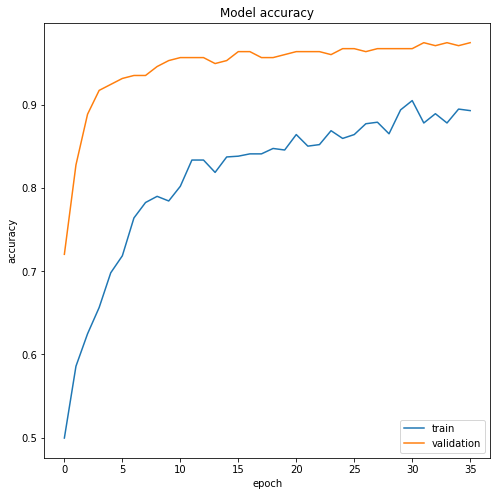

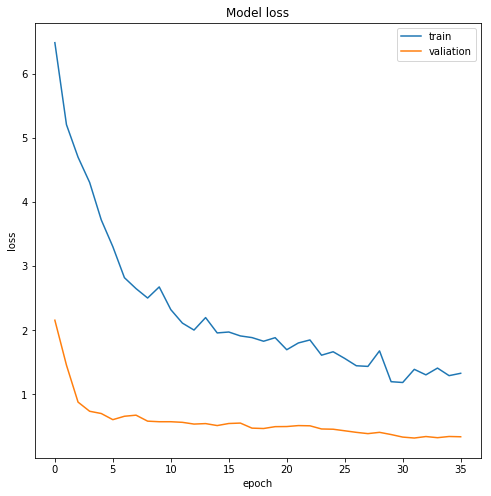

In [28]:
# history for accuracy
plt.figure(figsize=(8, 8)) 
plt.plot(history['acc'])
plt.plot(history['val_acc'])
plt.title('Model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='lower right')
plt.show()

# history for loss
plt.figure(figsize=(8, 8)) 
plt.plot(history['loss'])
plt.plot(history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'valiation'], loc='upper right')
plt.show()

In [42]:
class_mapping = {v:k for k,v in train_generator.class_indices.items()}

def predict_person_scenary(img_data, model):
    """ gives us the labels from the softmax output
        
    """
    preds = model.predict(img_data)
    decoded = class_mapping[np.argmax(preds[0])]
    return decoded

100%|██████████| 9/9 [00:00<00:00, 106.12it/s]


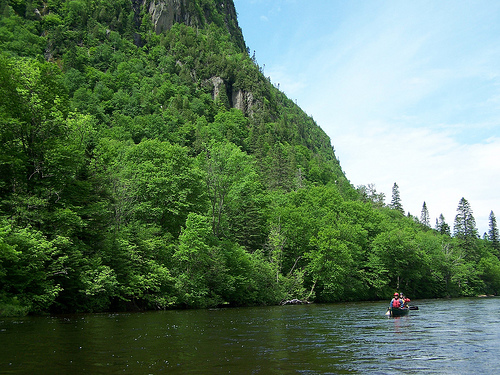

scenery


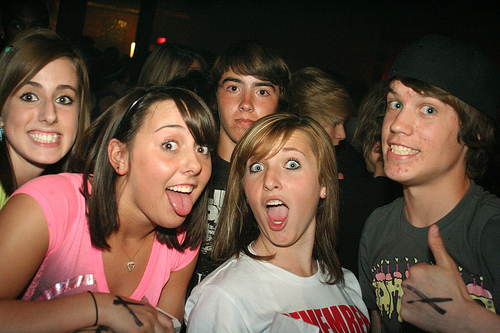

person


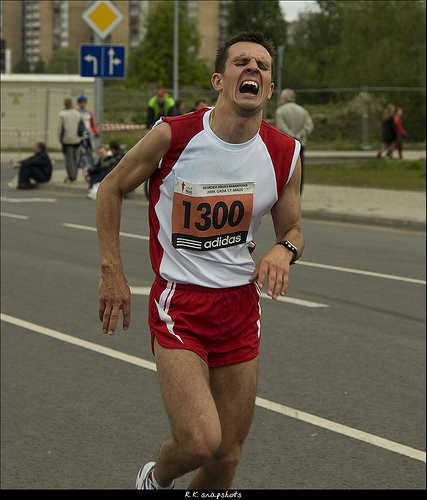

person


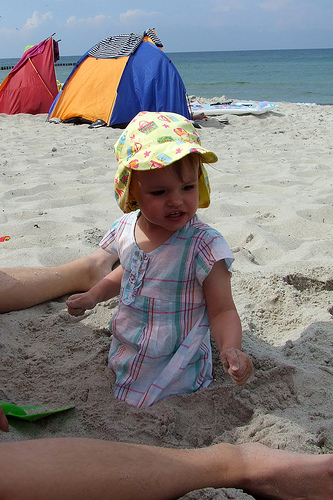

person


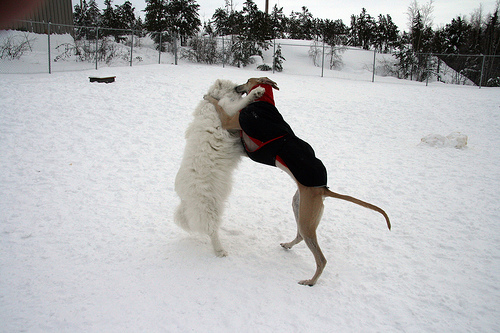

scenery


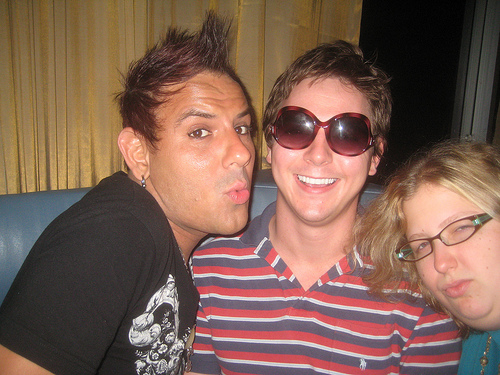

person


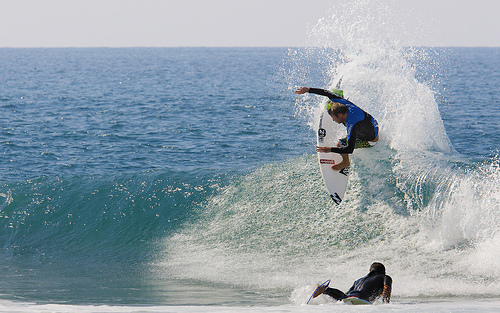

scenery


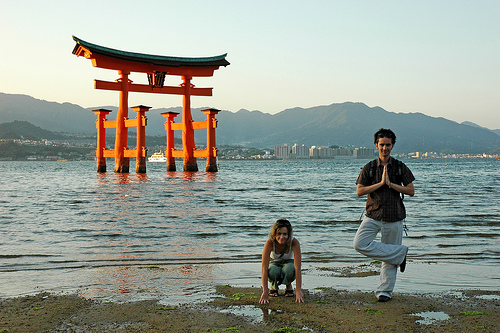

scenery


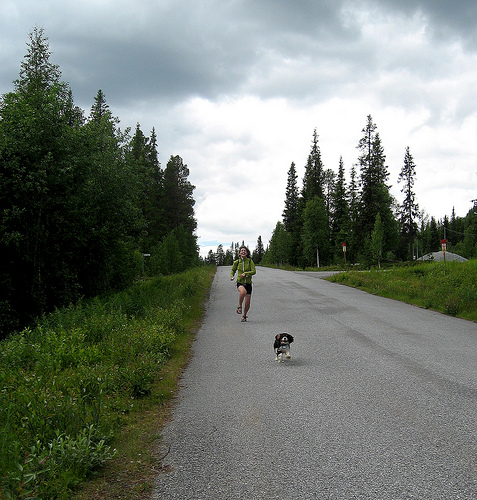

scenery


In [43]:
folder = "Test/abstract_classification"
list_img = read_images_in_folder(folder,preprocess=preprocess_input)

for img_idx in range(len(list_img[0])):
    decoded = predict_person_scenary(list_img[0][img_idx],abstract_model)
    display_image_and_caption(list_img[1][img_idx],decoded)